# 1. Import modules and load MERFISH data 

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import anndata
import scanpy as sc
import os

import matplotlib.pyplot as plt

sc.settings.n_jobs = 24
sc.settings.set_figure_params(dpi=180, dpi_save=300, frameon=False, figsize=(4, 4), fontsize=8, facecolor='white')

# 2. Load MERLin analysis results

In [28]:
merlin_output_folder = r'\\mendel\Mendel_SSD3\MERFISH_Analysis\20220601-hSTG'
# generate post-analysis folders
postanalysis_folder = os.path.join(merlin_output_folder, 'PostAnalysis')
if not os.path.exists(postanalysis_folder):
    print(f"Create postanalysis_folder: {postanalysis_folder}")
    os.makedirs(postanalysis_folder)
else:
    print(f"Use postanalysis_folder: {postanalysis_folder}")

Use postanalysis_folder: \\mendel\Mendel_SSD3\MERFISH_Analysis\20220601-hSTG\PostAnalysis


In [226]:
figure_folder = os.path.join(postanalysis_folder, 'Figures')
if not os.path.exists(figure_folder):
    print(f"Create figure_folder: {figure_folder}")
    os.makedirs(figure_folder)
else:
    print(f"Use figure_folder: {figure_folder}")

sc.settings.figdir = figure_folder

Create figure_folder: \\mendel\Mendel_SSD3\MERFISH_Analysis\20220601-hSTG\PostAnalysis\Figures


## Load metadata

In [29]:
# Load Cell information
cell_meta_data_file = os.path.join(merlin_output_folder, 'ExportCellMetadata', 'feature_metadata.csv')
cell_meta_data = pd.read_csv(cell_meta_data_file)
cell_meta_data

,Unnamed: 0,fov,volume,center_x,center_y,min_x,max_x,min_y,max_y
0,110124456874985853069507432530619470880,0,1114.076753,1012.514001,1977.040030,1005.105201,1019.922801,1970.333230,1983.746830
1,128224319977154751720927515902974301198,0,126.711871,1001.444001,1855.432027,999.273201,1003.614801,1851.857227,1859.006827
2,129584453420898728523966076716116701696,0,1265.890137,1129.424004,1790.632025,1122.069204,1136.778804,1783.709225,1797.554825
3,13269268440827567470179653347485630483,0,1394.380767,986.324000,1979.518630,978.321200,994.326801,1972.061230,1986.976030
4,133220283375320180299466190337031733763,0,193.428671,1085.684003,1880.326027,1082.325203,1089.042803,1877.129227,1883.522827
...,...,...,...,...,...,...,...,...,...
10771,78111406544686444172343830760198752382,204,1094.956424,1169.303987,2247.617944,1163.083187,1175.524787,2241.559144,2253.676744
10772,88345078996985707988953969424490868301,204,511.195239,1235.772589,2178.551943,1230.799188,1240.745989,2173.195142,2183.908743
10773,91387999115559760550902214920664808925,204,258.402053,1209.101988,2270.567945,1206.175188,1212.028788,2266.615145,2274.520745
10774,92812055550637872022309113935886089320,204,142.100653,1074.155984,2347.355947,1071.607184,1076.704784,2344.051147,2350.660747


In [ ]:
# Load decoded counts information
counts_file_mer = os.path.join(merlin_output_folder, 'ExportPartitionedBarcodes', 'barcodes_per_feature.csv')
df = pd.read_csv(counts_file_mer).rename(columns={'Unnamed: 0':'index'}).set_index('index')

In [193]:
# remove blanks
blanks = [_c for _c in df.columns if 'Blank-' in _c]
df = df.drop(columns=blanks)

adata = anndata.AnnData(df)
adata.obs = adata.obs.merge(cell_meta_data, left_index=True, right_on='Unnamed: 0').set_index('Unnamed: 0')

df

,SORBS2,NTNG1,FBN2,PAX6,ADAMTS6,DCN,CHST9,C10orf11,ROR2,SLC22A25,...,ADAMTS17,ANKRD36BP2,ADAMTS19,HGF,KIAA1024,GLIS3,BEND4,DNAH6,ANKRD30B,BMP6
index,,,,,,,,,,,,,,,,,,,,,
110124456874985853069507432530619470880,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
128224319977154751720927515902974301198,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
129584453420898728523966076716116701696,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
13269268440827567470179653347485630483,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
133220283375320180299466190337031733763,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
78111406544686444172343830760198752382,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
88345078996985707988953969424490868301,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
91387999115559760550902214920664808925,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0


# 4. Preprocess and filter the MERFISH data 

In [194]:
# Calculate quality control metrics
sc.pp.calculate_qc_metrics(adata, percent_top=None, log1p=False, inplace=True)

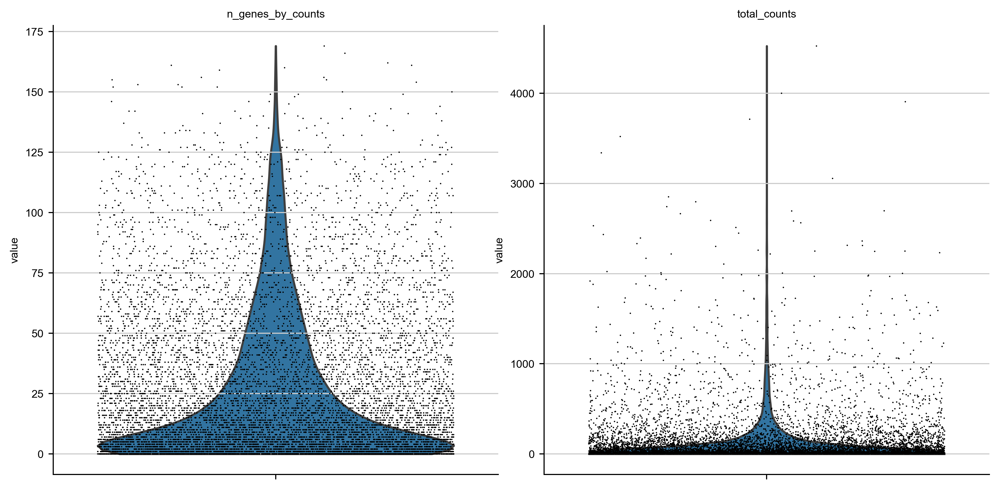

In [195]:
# A violin plot of some of the computed quality measures:
# - the number of genes expressed in the count matrix
# - the total counts per cell
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts'],
             jitter=0.4, multi_panel=True)

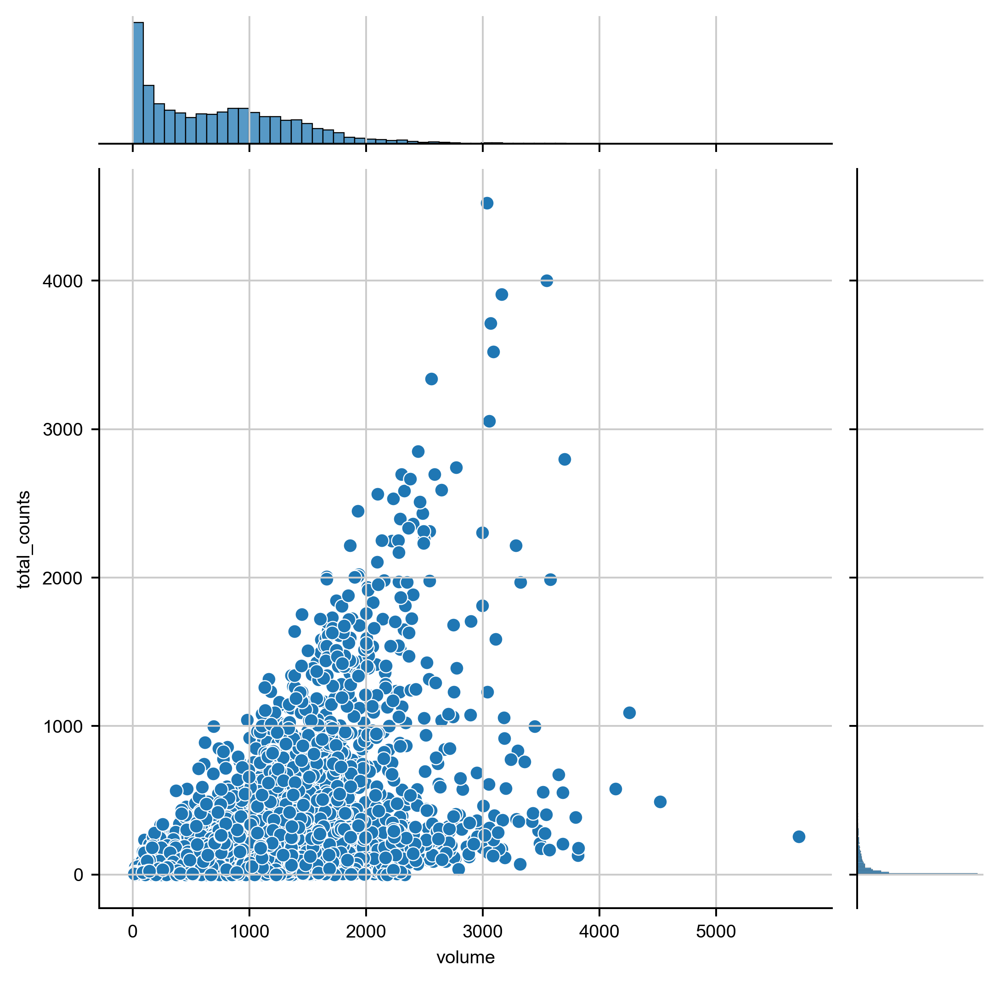

In [196]:
sns.jointplot(data=adata.obs, x='volume', y='total_counts')

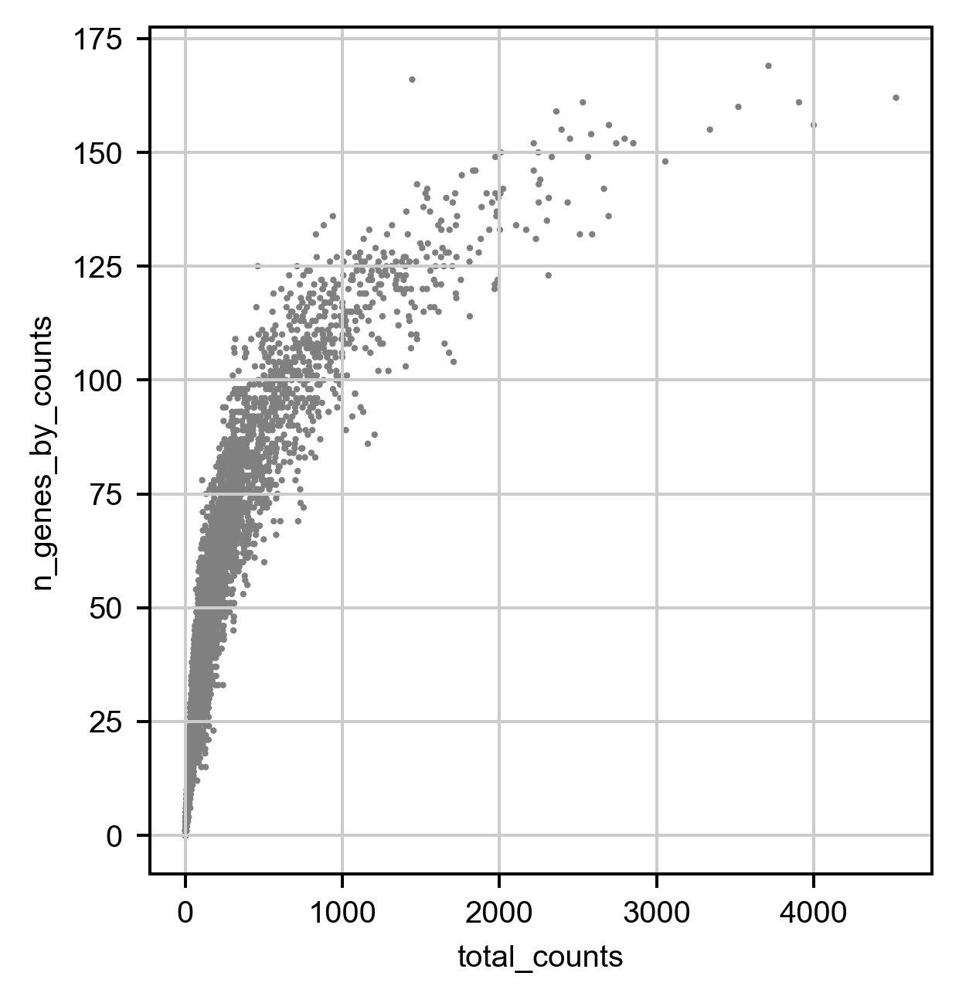

In [197]:
# Plot the distributions of gene counts
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')

In [198]:
gene_count_threshold = 10
total_count_threshold = 20
volume_threshold = 200
volume_upper_threshold = 6000
# Filtering
adata = adata[adata.obs['n_genes_by_counts'] > gene_count_threshold]
adata = adata[adata.obs['total_counts'] > total_count_threshold]
adata = adata[adata.obs['volume'] > volume_threshold]
adata = adata[adata.obs['volume'] <= volume_upper_threshold]

print(len(adata) / len(cell_meta_data) , len(adata))

0.4893281365998515 5273


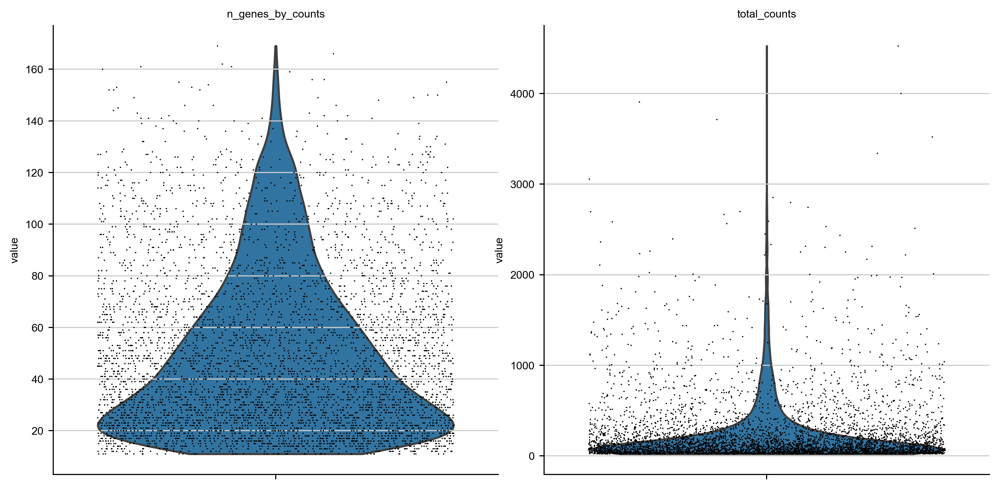

In [227]:
# A violin plot of some of the computed quality measures:
# - the number of genes expressed in the count matrix
# - the total counts per cell
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts'],
             jitter=0.4, multi_panel=True, save='_after_filter_counts.png')

## 4. PCA and UMAP of the MERFISH data (for quick test)

E:\Users\puzheng\AppData\anaconda3\envs\merlin_postanalysis\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


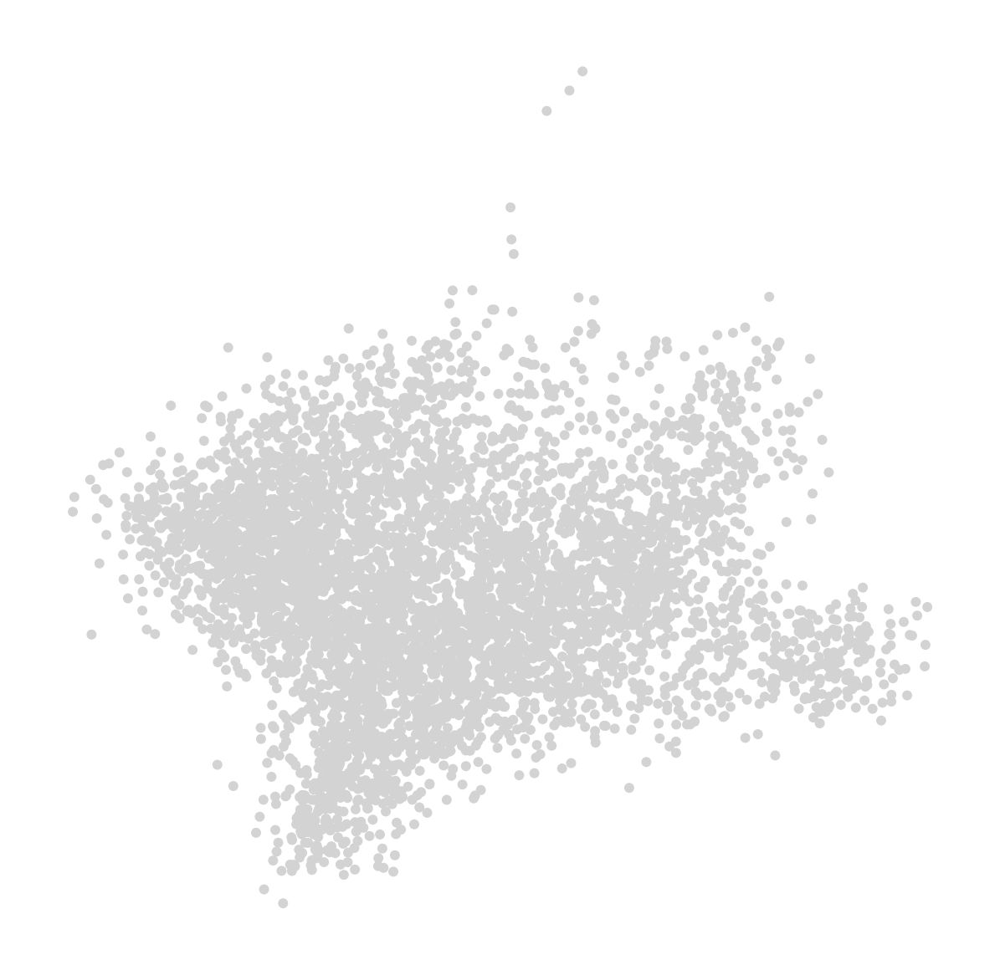

Wall time: 17.7 s


In [200]:
%%time
# Total-count normalize (library-size correct) the data matrix to 10,000 reads per cell
sc.pp.normalize_total(adata, target_sum=1e2)
# Logarithmize the data
sc.pp.log1p(adata)
# Regress out total counts
sc.pp.regress_out(adata, 'total_counts')
# Convert gene expressions to Z-scores
sc.pp.scale(adata, max_value=10)
# Principal component analysis
sc.tl.pca(adata, svd_solver='arpack')
# Plot the PCA results
sc.pl.pca(adata)

In [201]:
%%time
# Computing the neighborhood graph
sc.pp.neighbors(adata, n_neighbors=5, n_pcs=30)

Wall time: 1.97 s


In [214]:
%%time
# Clustering
sc.tl.leiden(adata, resolution=0.4)

Wall time: 200 ms


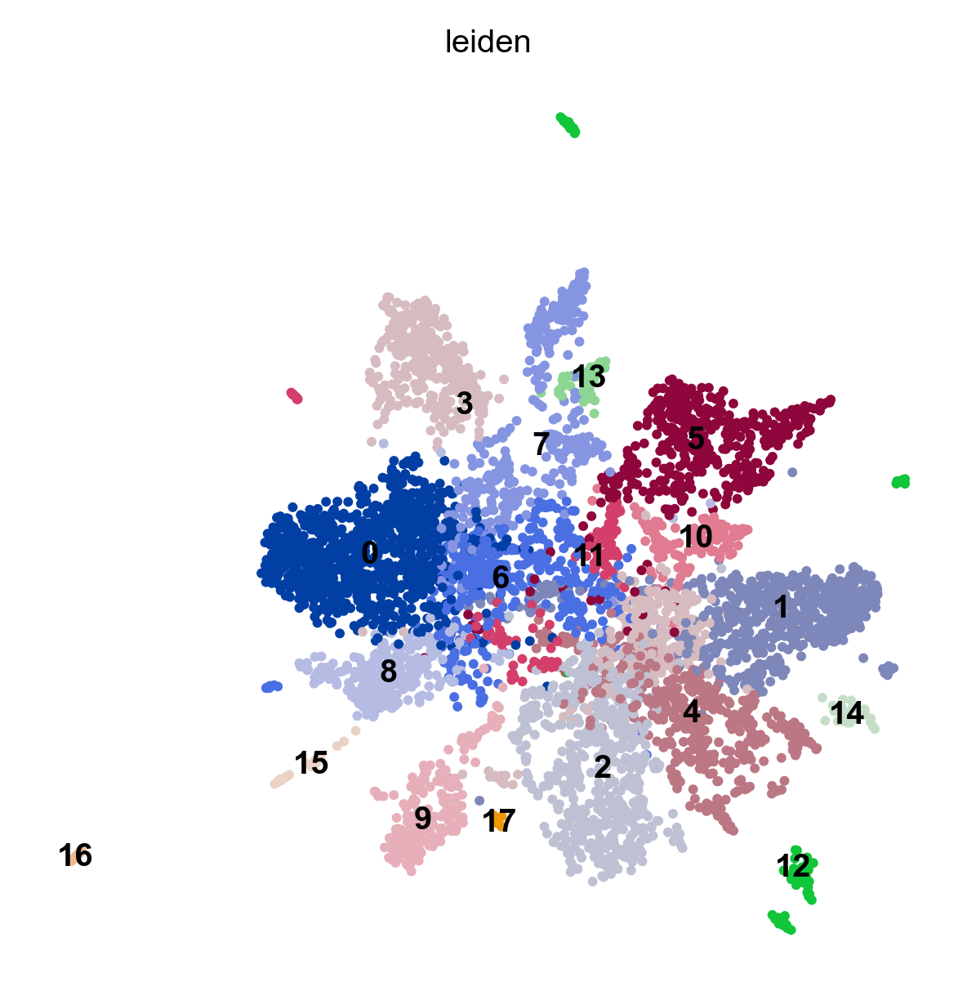

Wall time: 29.2 s


In [215]:
%%time
# Embed with UMAP
sc.tl.umap(adata)
# Plot the UMAP
sc.pl.umap(adata, color='leiden', legend_loc='on data')

## 5. Check count for each cell for genes of interest

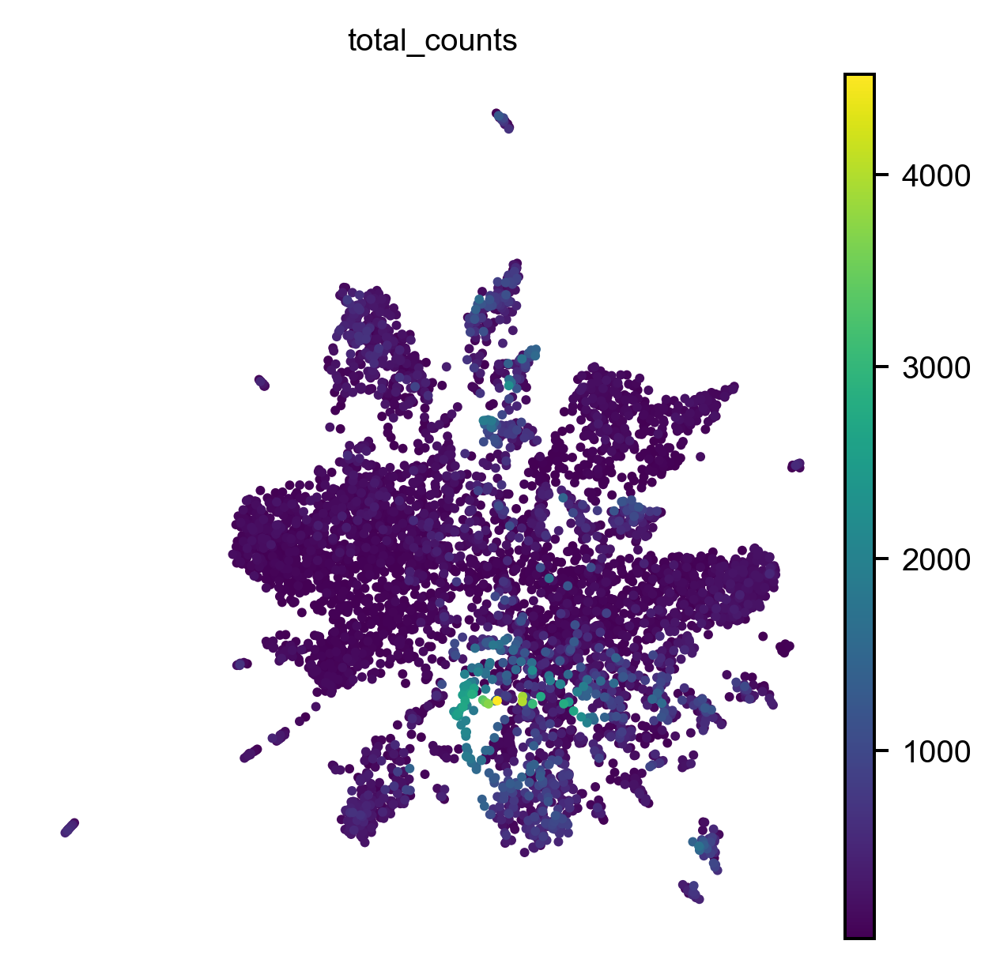

In [216]:
sc.pl.umap(adata, color='total_counts')

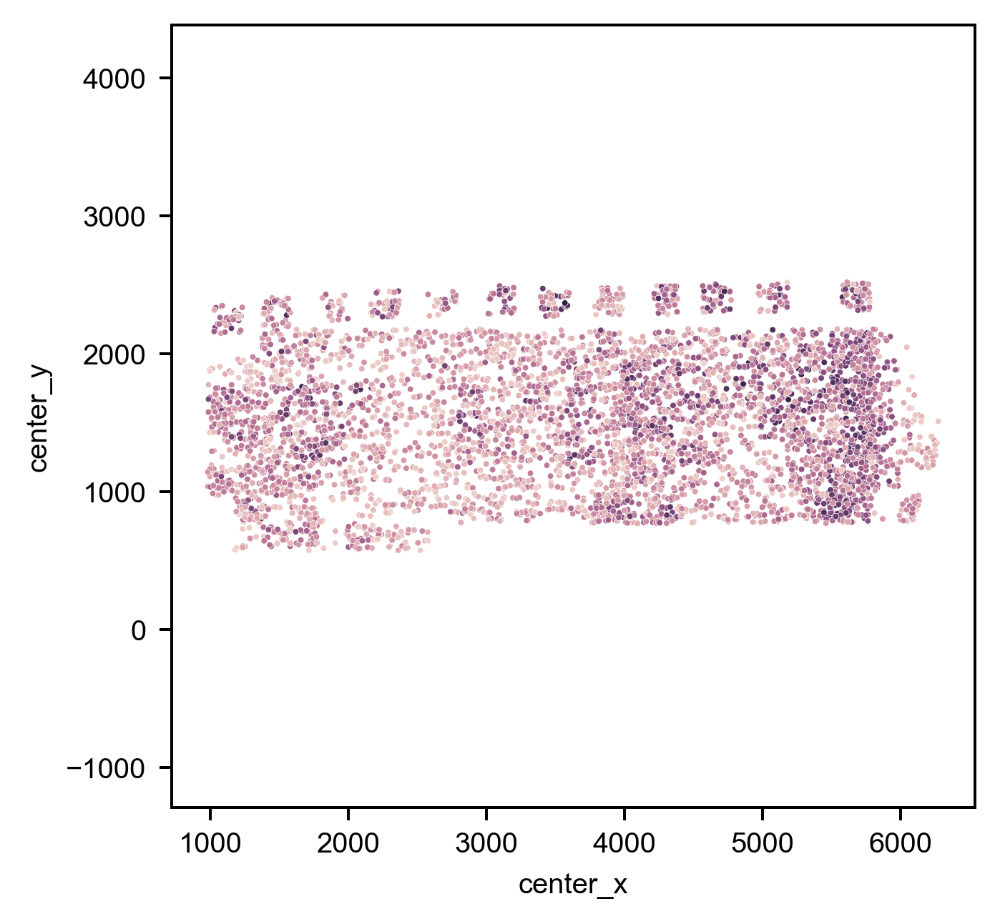

In [218]:
# visualzie the spatial dist for clusters
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
#plt.style.use('dark_background')
ax = sns.scatterplot(data=adata.obs, x='center_x', y='center_y', 
                hue='total_counts', hue_norm=LogNorm(), s=3, legend=False, )
ax.grid(False)
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
#ax.legend(hs,ls, ncol=8, loc=8)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])

# 6.UMAP can be done using different settings and can be saved into different label column for cell type classifer use later

## 6.1 Use higher expected pcs and resolution to UMAP for cell-type distinction at "cluster" level

In [219]:
# direcly use previous leiden
adata.obs['leiden_cluster'] = adata.obs.leiden

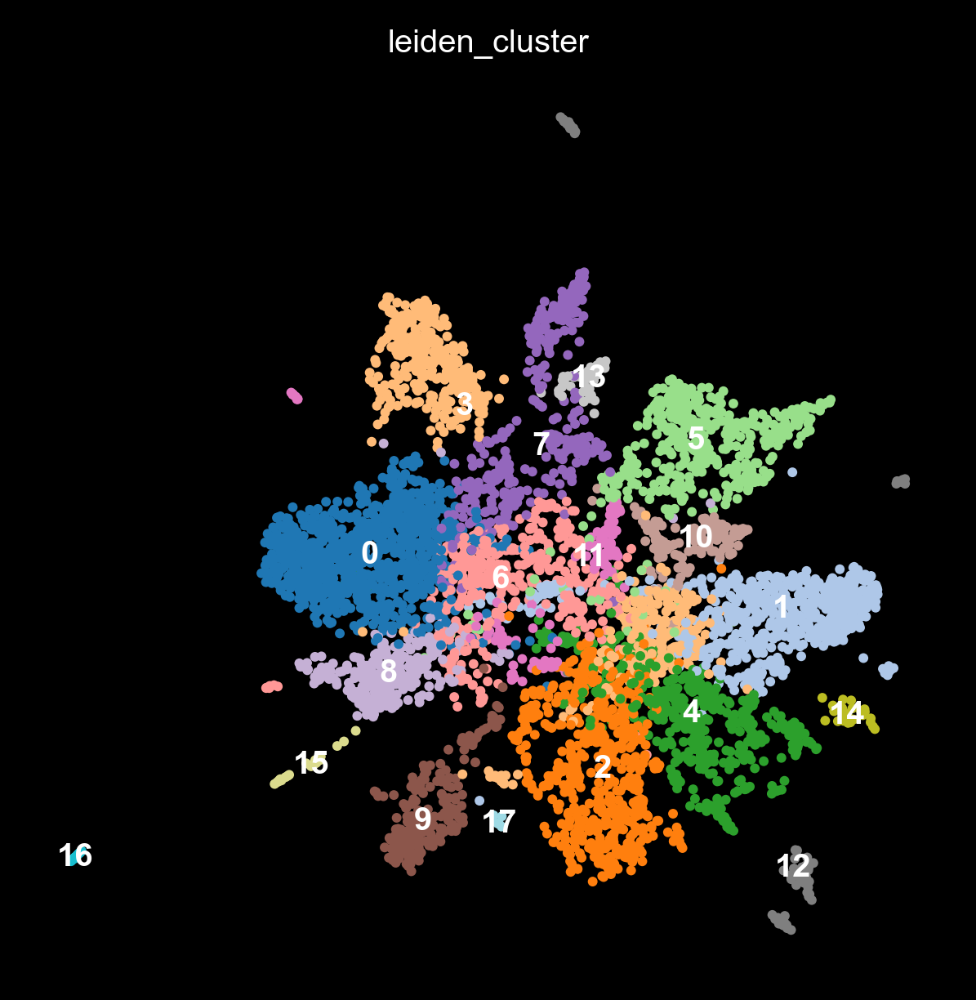

In [260]:
plt.style.use('dark_background')

sc.pl.umap(adata, color='leiden_cluster', 
           legend_loc='on data',
           palette='tab20',
           save='_dark_cluster.png',
           )

In [248]:
adata

AnnData object with n_obs × n_vars = 5273 × 250
    obs: 'fov', 'volume', 'center_x', 'center_y', 'min_x', 'max_x', 'min_y', 'max_y', 'n_genes_by_counts', 'total_counts', 'leiden', 'leiden_cluster'
    var: 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'mean', 'std'
    uns: 'log1p', 'pca', 'neighbors', 'leiden', 'umap', 'leiden_colors', 'rank_genes_groups', 'leiden_cluster_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [251]:
adata.uns['leiden_cluster_colors'] = adata.uns['leiden_cluster_colors'][:12]

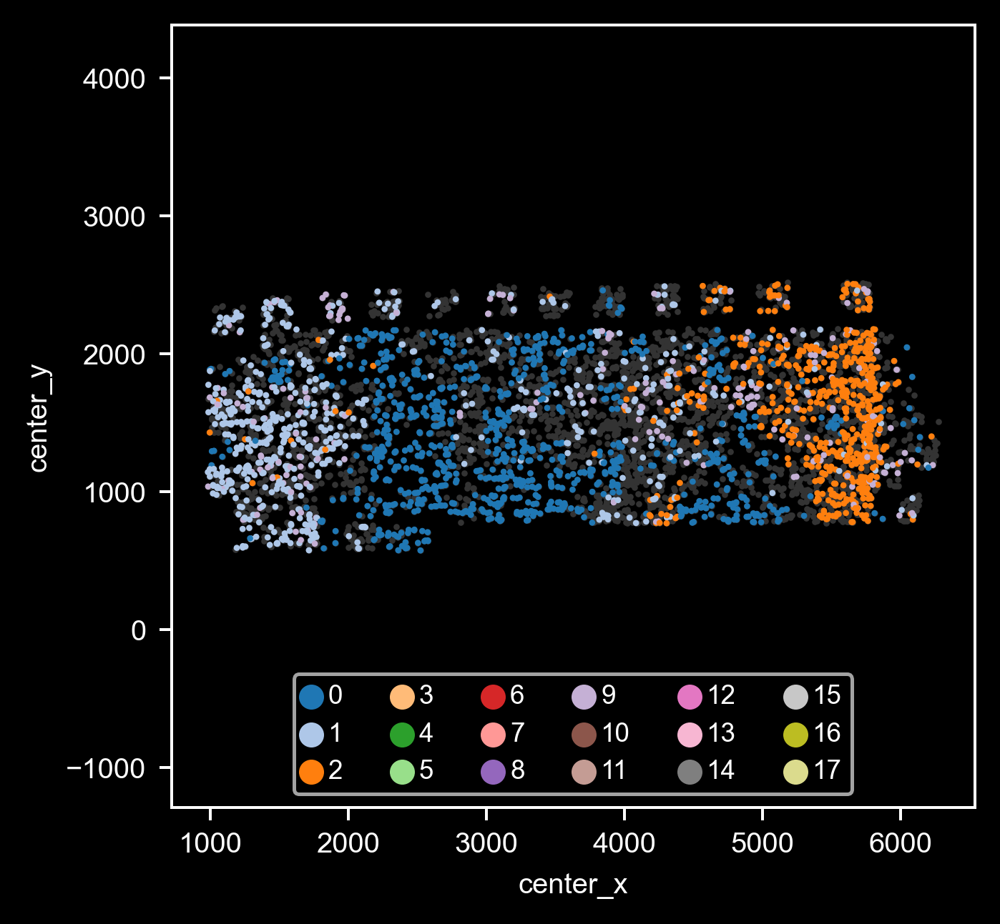

In [263]:
# visualzie the spatial dist for clusters
import matplotlib.pyplot as plt
#plt.style.use('dark_background')
sel_clusters = ['0', '1', '2', '9']

sel_inds = [_i for _i, _cls in zip(adata.obs.index, adata.obs['leiden_cluster']) if _cls in sel_clusters]
ax1 = sns.scatterplot(data=adata.obs, x='center_x', y='center_y', 
                      color=[0.2,0.2,0.2], s=3, legend=True, linewidth=0)

ax = sns.scatterplot(data=adata.obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='tab20',
                     hue='leiden_cluster', s=3, legend=True, linewidth=0)
ax.grid(False)
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=6, loc=8)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
plt.savefig(os.path.join(figure_folder, 'spatial_sel_clusters.png'), transparent=True)

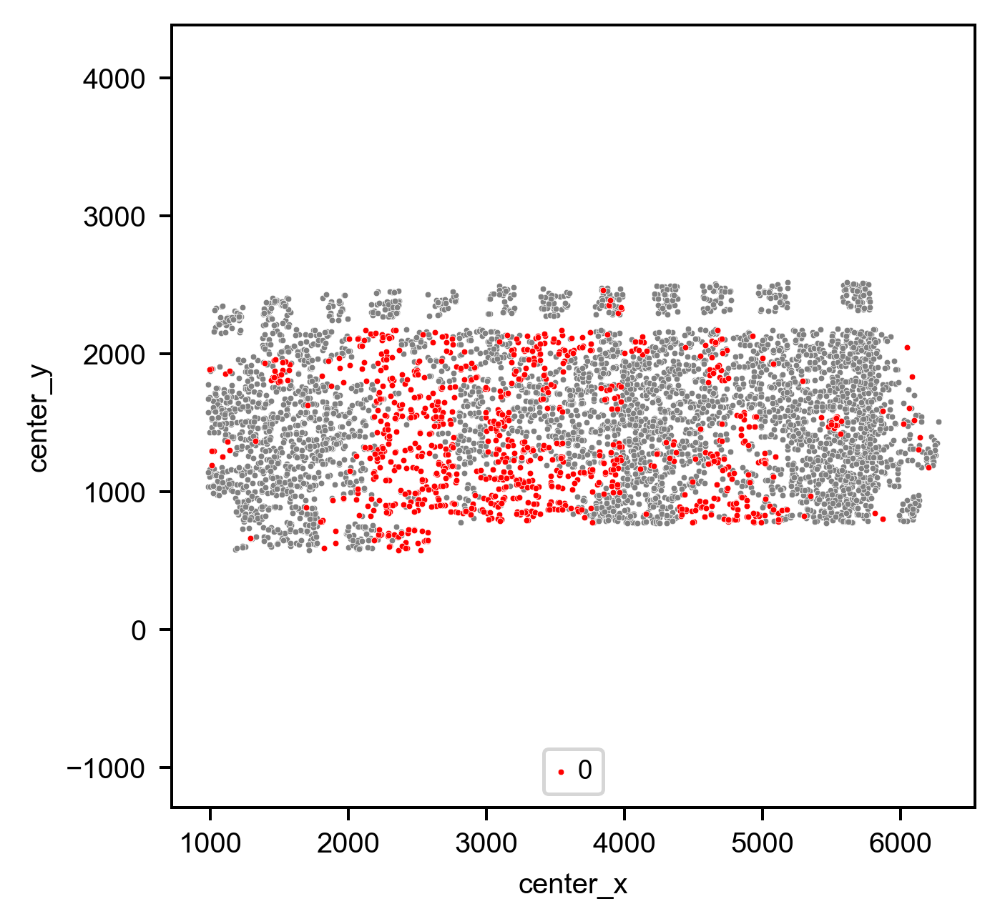

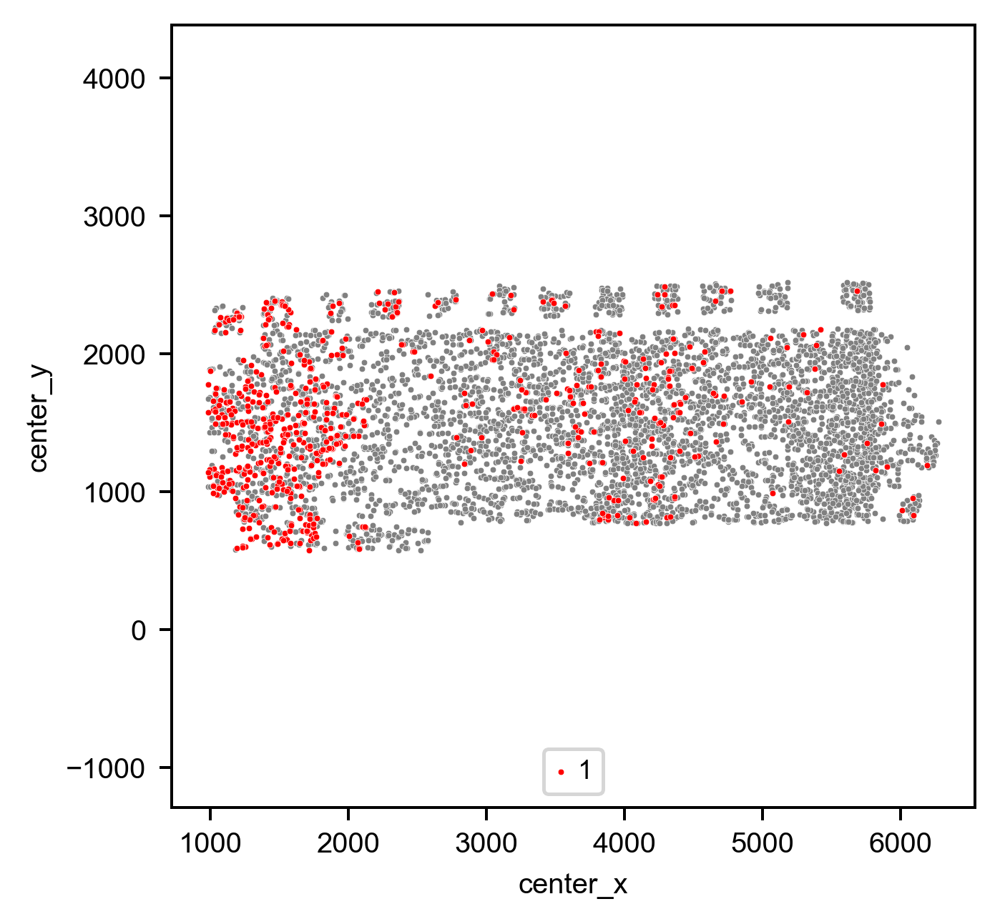

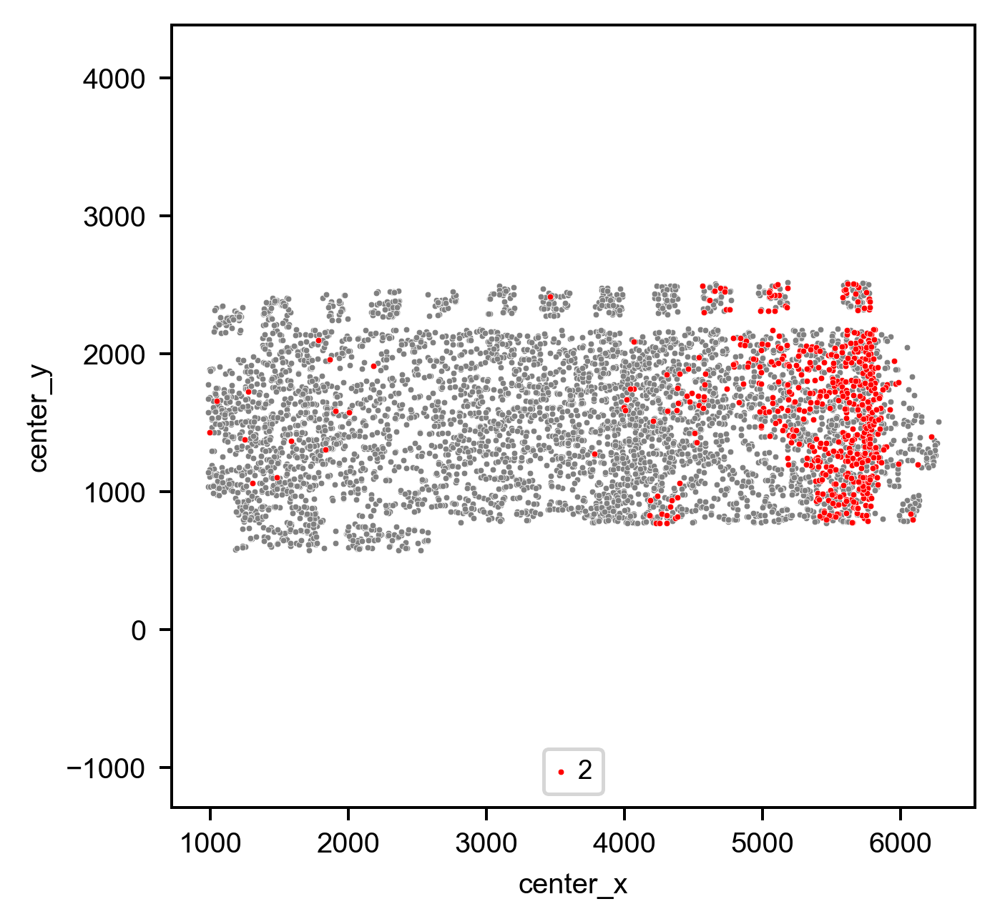

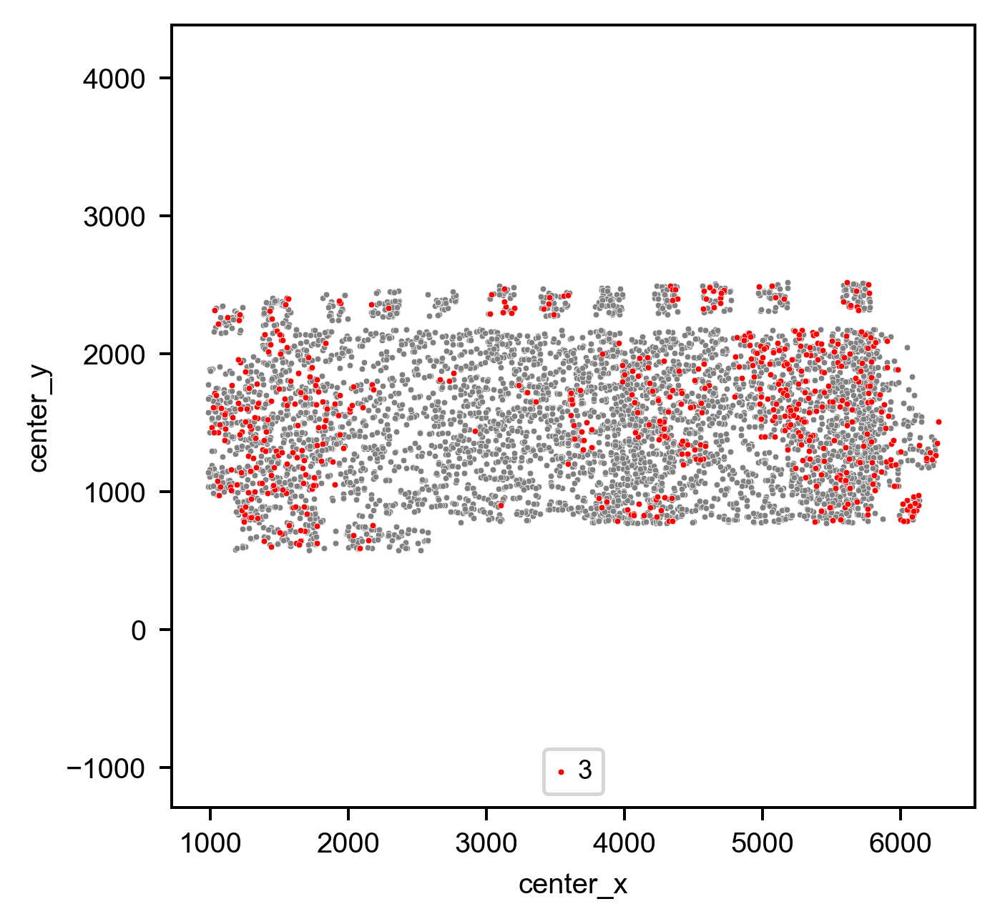

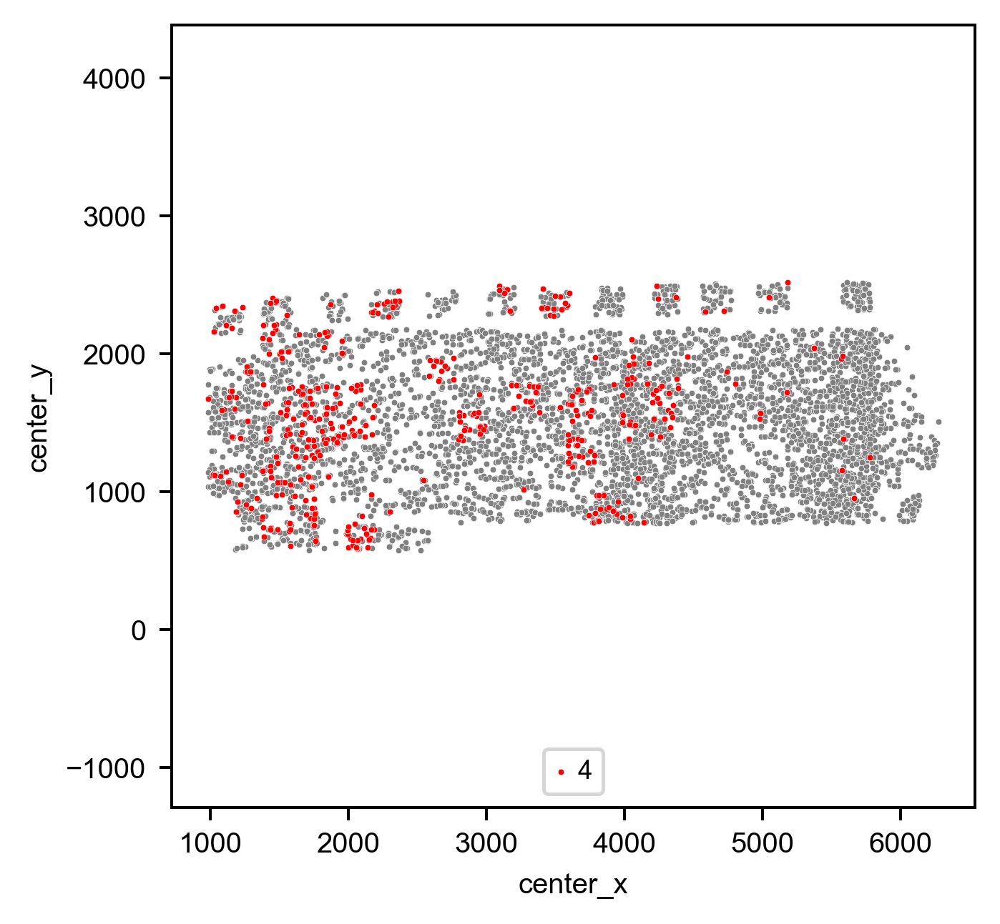

...

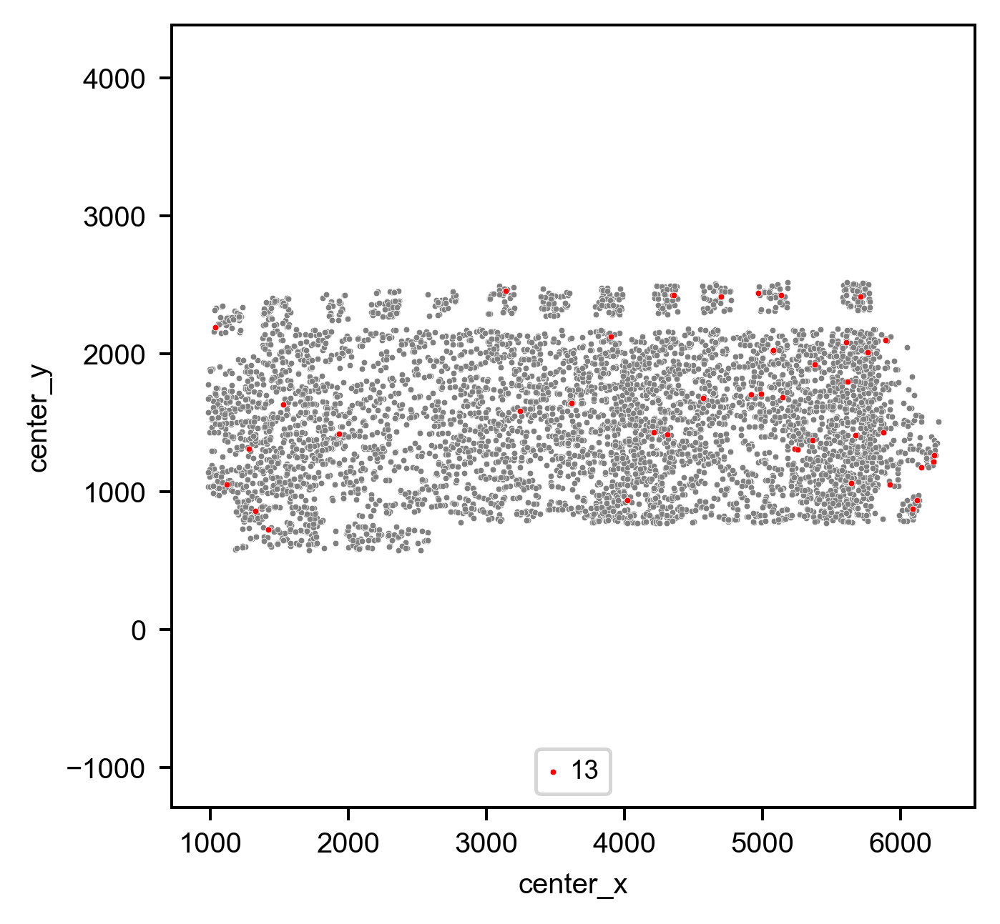

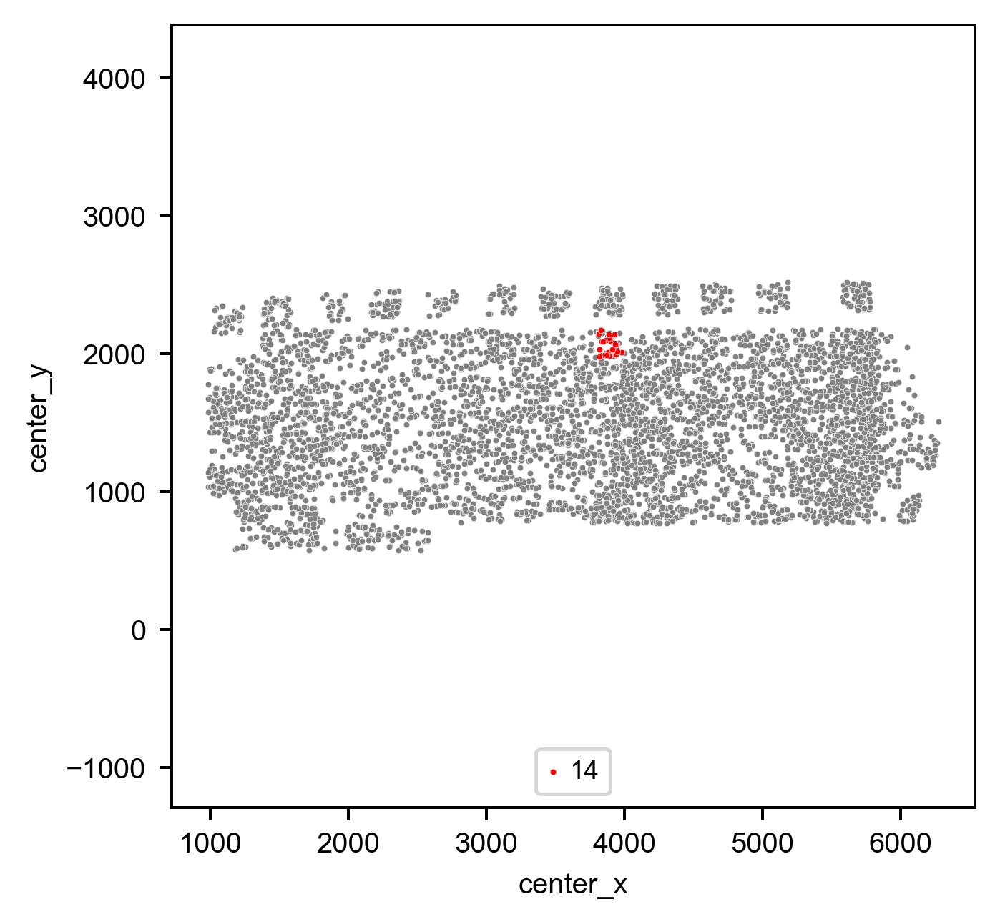

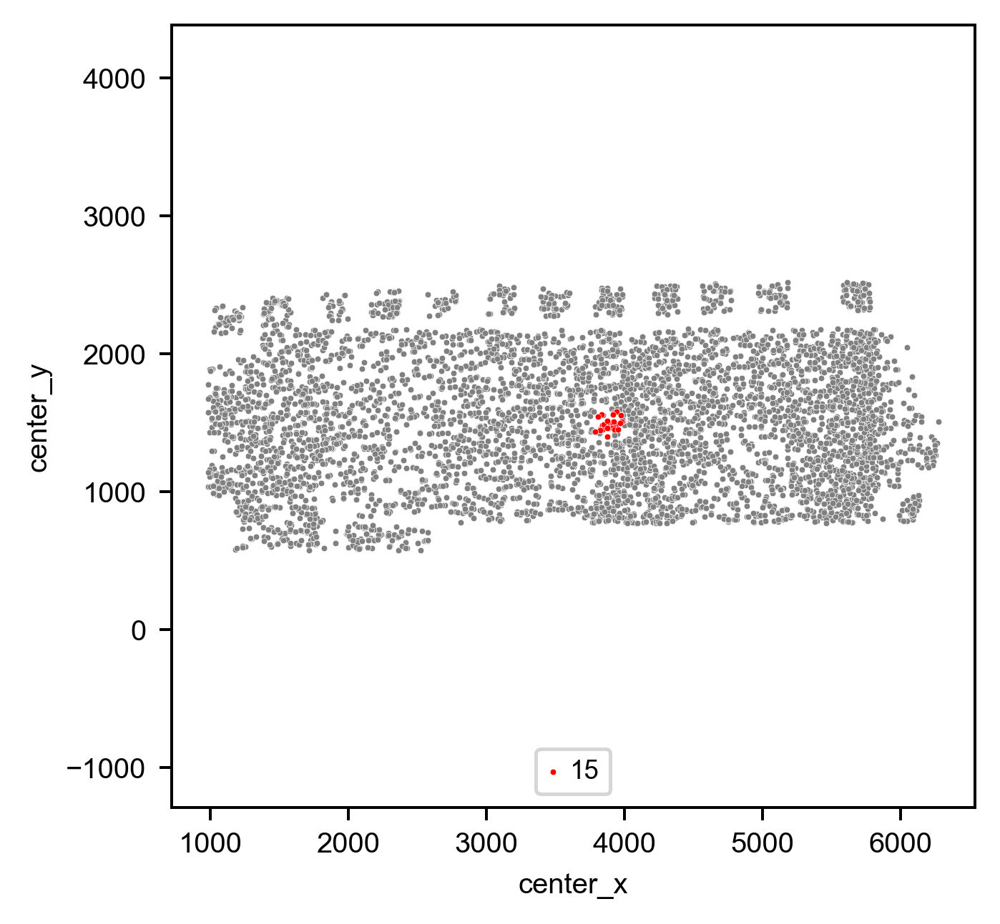

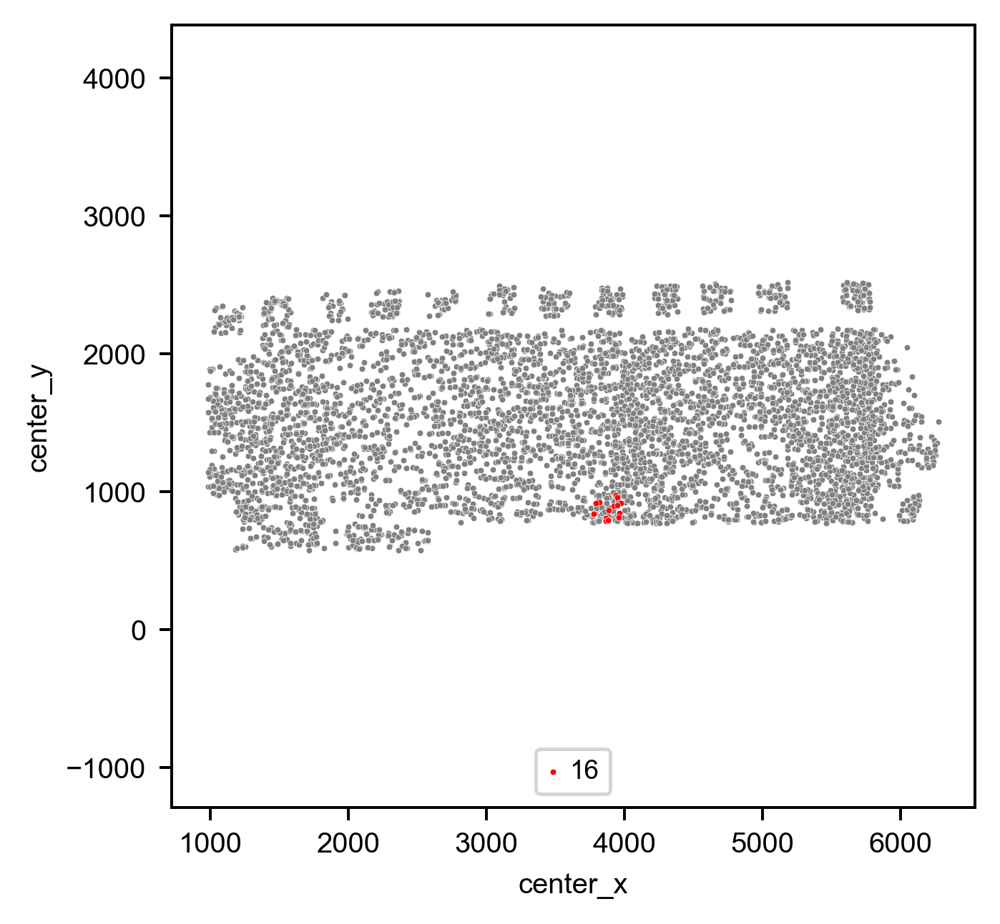

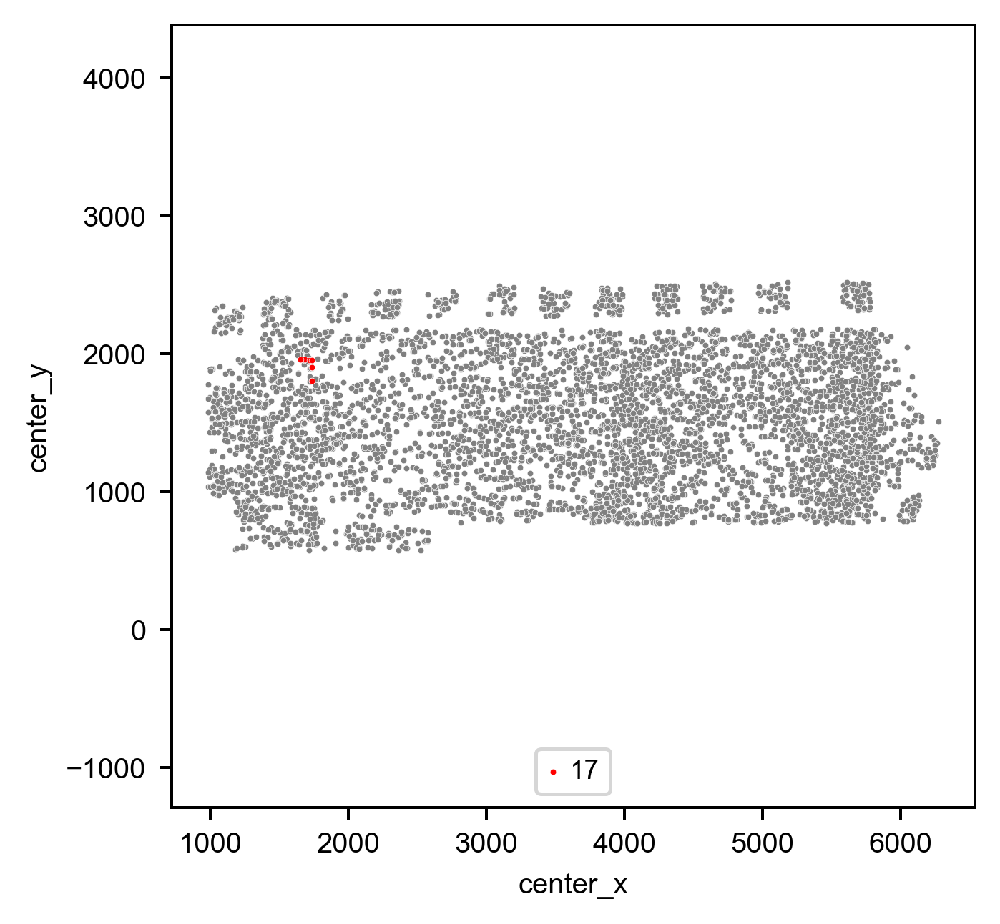

In [222]:
# visualzie the spatial dist for clusters
import matplotlib.pyplot as plt
for _class in sorted(np.unique(adata.obs['leiden_cluster']), key=lambda v:int(v)):
    #plt.style.use('dark_background')
    ax = sns.scatterplot(data=adata.obs, x='center_x', y='center_y', 
                    color='grey', s=3, legend=True,)
    ax = sns.scatterplot(data=adata.obs.loc[adata.obs['leiden_cluster']==_class], 
                         x='center_x', y='center_y', 
                    color='r', s=3, legend=True, label=_class)
    ax.grid(False)
    plt.axis('equal')
    hs, ls = ax.get_legend_handles_labels()
    ax.legend(hs,ls, ncol=8, loc=8)
    plt.show()

E:\Users\puzheng\AppData\anaconda3\envs\merlin_postanalysis\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
E:\Users\puzheng\AppData\anaconda3\envs\merlin_postanalysis\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
E:\Users\puzheng\AppData\anaconda3\envs\merlin_postanalysis\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
E:\Users\puzheng\AppData\anaconda3\envs\merlin_postanalysis\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
E:\Users\puzheng\AppData\anaconda3\envs\merlin_postanalysis\lib\site-packages\scanpy\tools\_rank_genes_groups.py

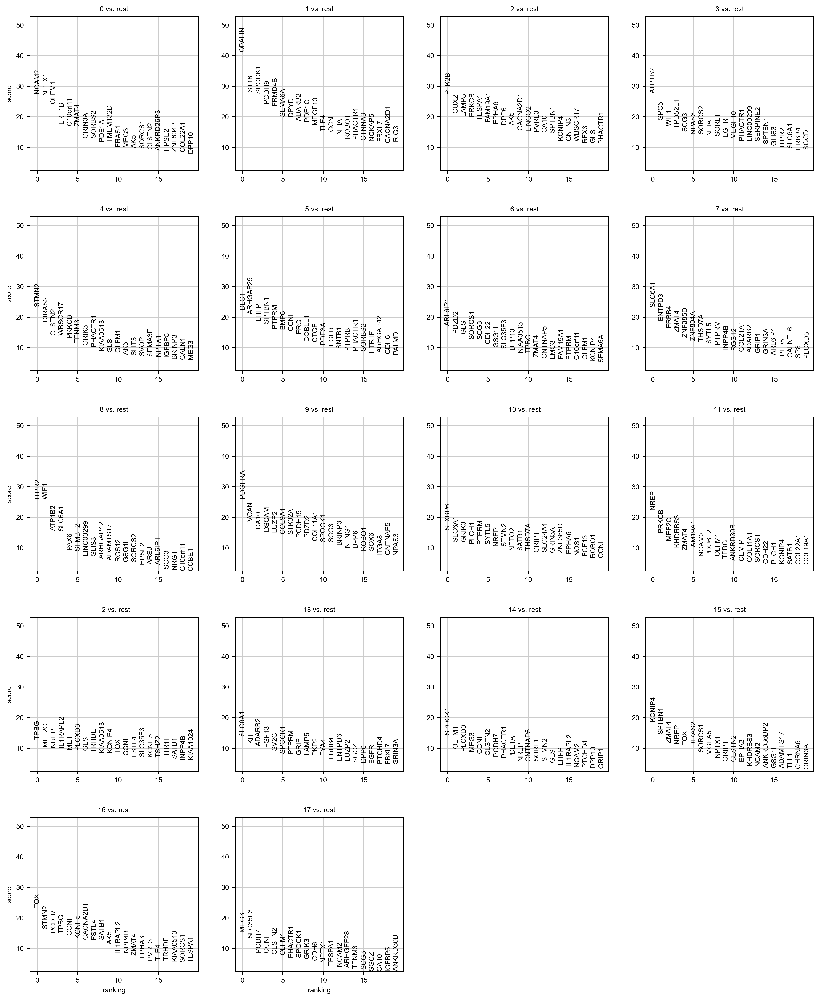

In [224]:
sc.tl.rank_genes_groups(adata, groupby='leiden_cluster', method='t-test')
sc.pl.rank_genes_groups(adata, groupby='leiden_cluster')

## 6.2 Use lower expected pcs and resolution to UMAP for cell-type distinction at subclass level

In [208]:
adata.obs

,fov,volume,center_x,center_y,min_x,max_x,min_y,max_y,n_genes_by_counts,total_counts,leiden,leiden_cluster
Unnamed: 0,,,,,,,,,,,,
142320197250352494256072602745612936423,0,857.667378,1018.400001,1890.694028,1007.589201,1029.210801,1884.149227,1897.238828,23,37.0,0,0
156761257491587559167497409252249664408,0,1596.058569,1006.952001,1891.288028,995.925201,1017.978801,1885.553228,1897.022828,48,117.0,3,3
189227905858180350481232268208850166860,0,757.331895,997.880001,1884.700027,992.145201,1003.614801,1878.965227,1890.434828,19,30.0,0,0
190039597872653147692304476348067612309,0,1676.932434,1109.228004,1853.542027,1102.305203,1116.150804,1845.701226,1861.382827,24,51.0,0,0
227464947648899746667305941428287555056,0,1672.450075,1070.078003,1907.704028,1061.265202,1078.890803,1899.809228,1915.598828,17,28.0,7,7
...,...,...,...,...,...,...,...,...,...,...,...,...
61305065502434563804869613531363898219,204,1096.045142,1118.705985,2260.955945,1111.891185,1125.520786,2253.439144,2268.472745,59,192.0,2,2
72692170342086683619306492520586639916,204,1363.300288,1138.469986,2246.267944,1132.087186,1144.852786,2238.643144,2253.892744,84,324.0,2,2
74138048957848290081878487802245139874,204,1107.778543,1157.693986,2263.763945,1150.987186,1164.400787,2257.759145,2269.768745,48,114.0,5,5


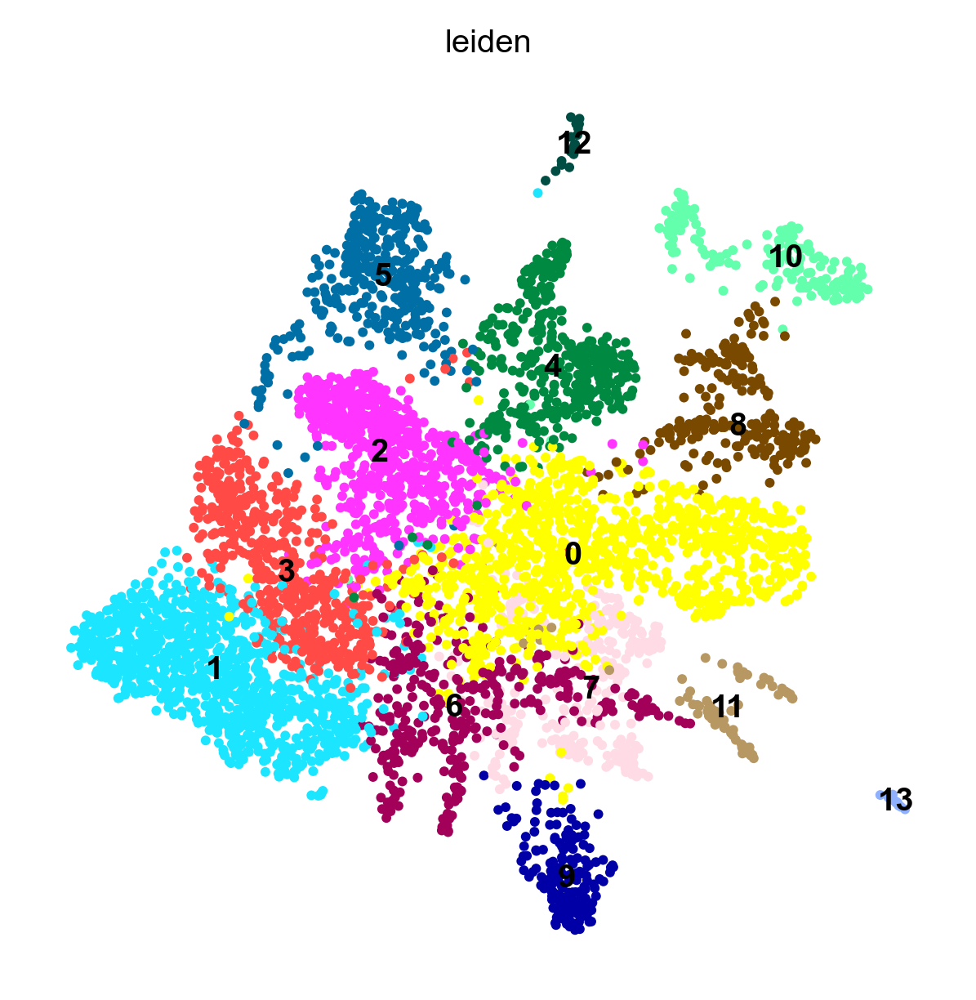

Wall time: 48.2 s


In [51]:
%%time
# Computing the neighborhood graph
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=50)

sc.tl.leiden(adata, resolution=0.5)

sc.tl.umap(adata)
# Plot the UMAP
sc.pl.umap(adata, color='leiden', legend_loc='on data')

# save this new labels as a new column as 'leiden_subclass'
adata.obs['leiden_subclass'] = adata.obs.leiden

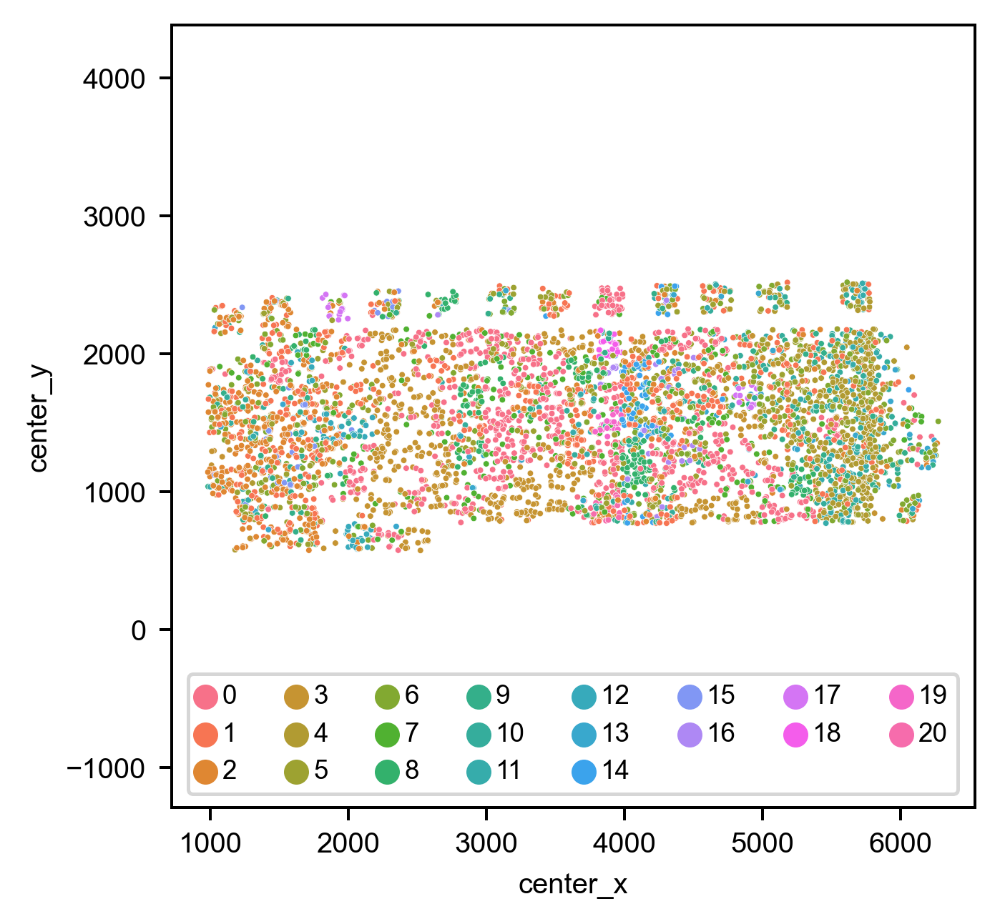

In [209]:
# visualzie the spatial dist for clusters
import matplotlib.pyplot as plt
#plt.style.use('dark_background')
ax = sns.scatterplot(data=adata.obs, x='center_x', y='center_y', 
                hue='leiden_subclass', s=3, legend=True,)
ax.grid(False)
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=8, loc=8)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])

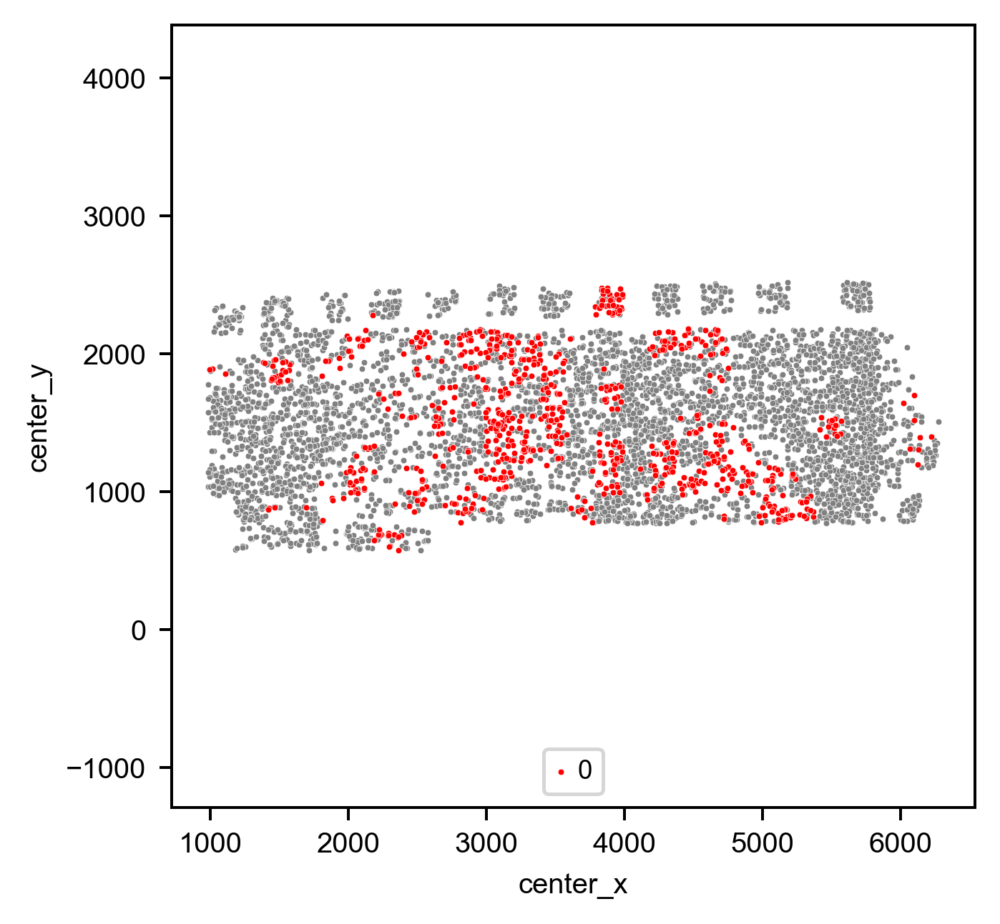

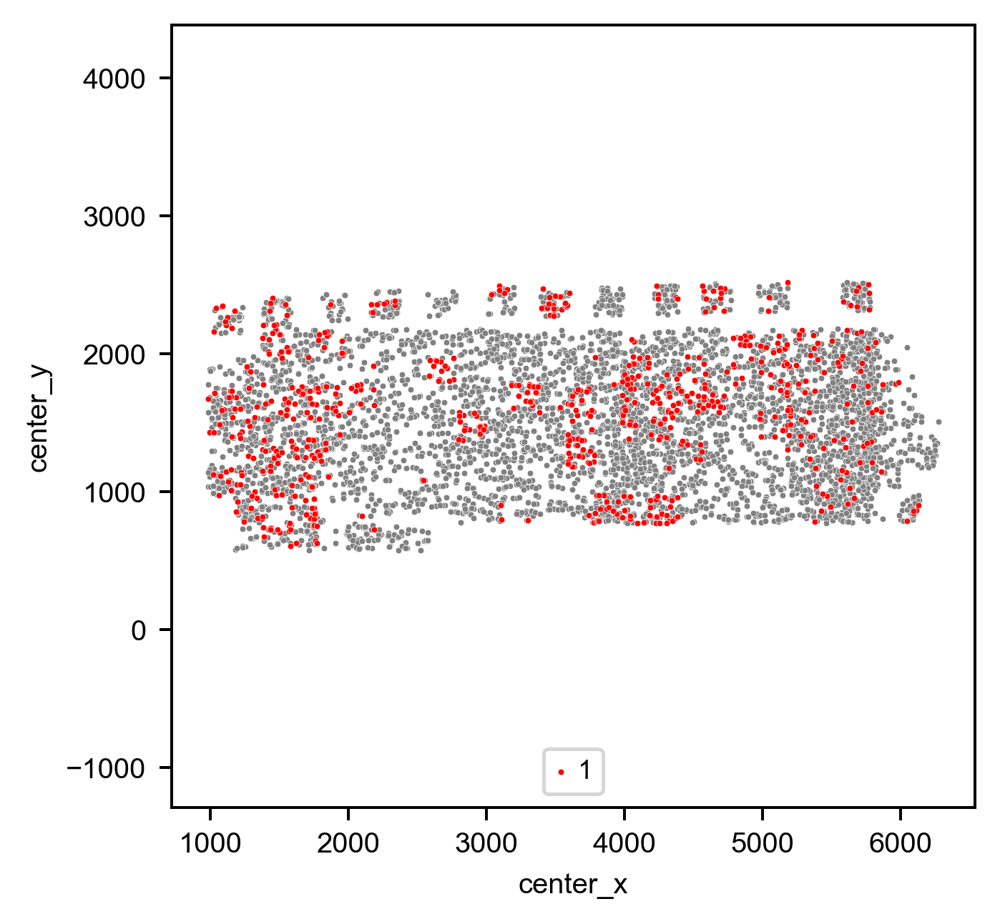

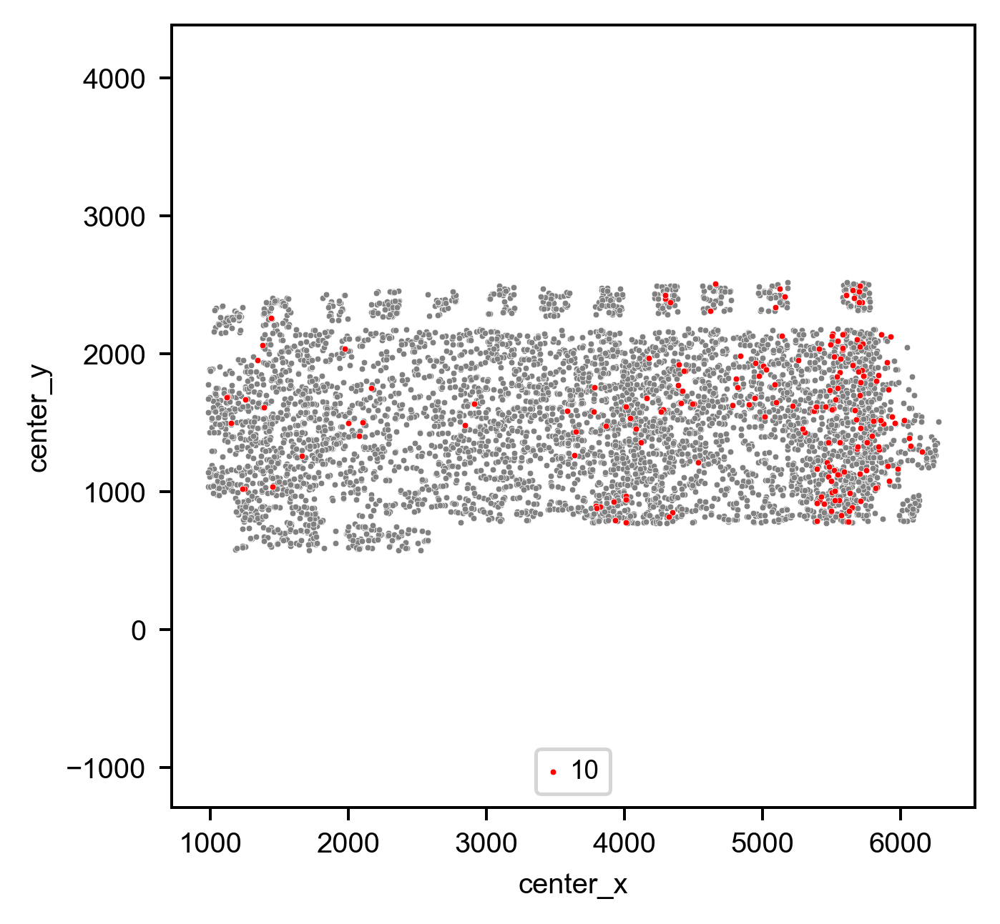

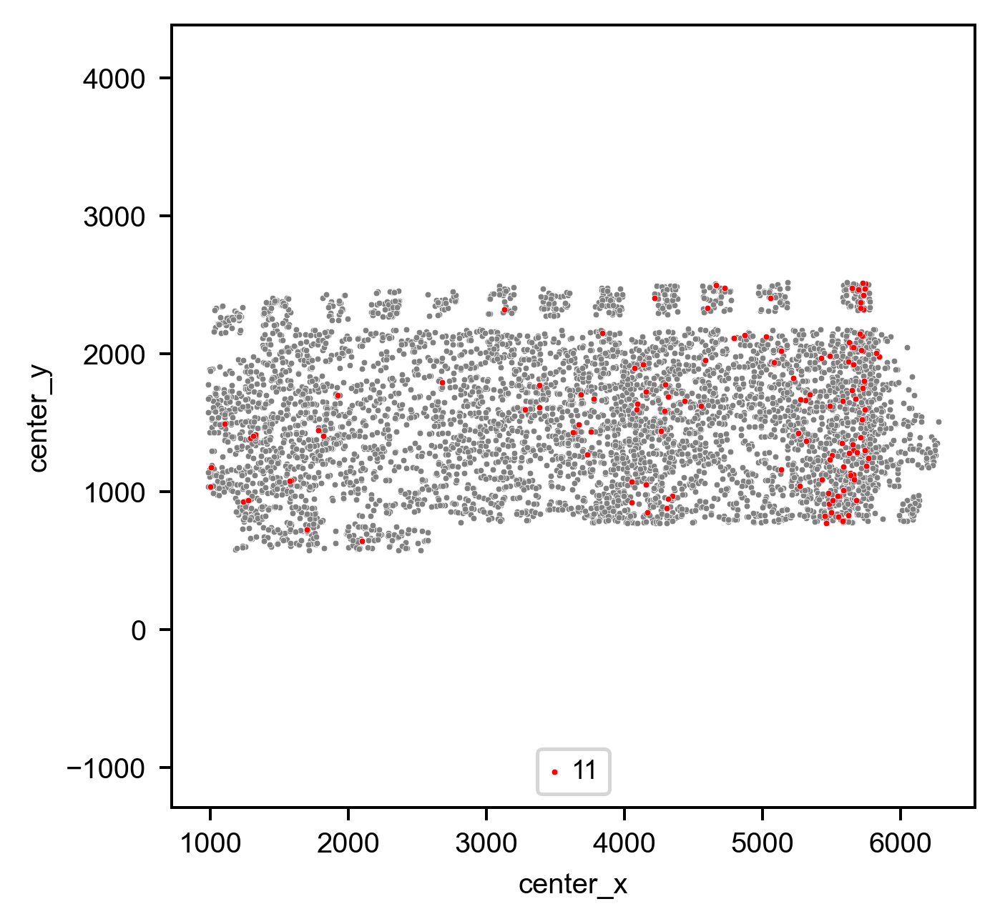

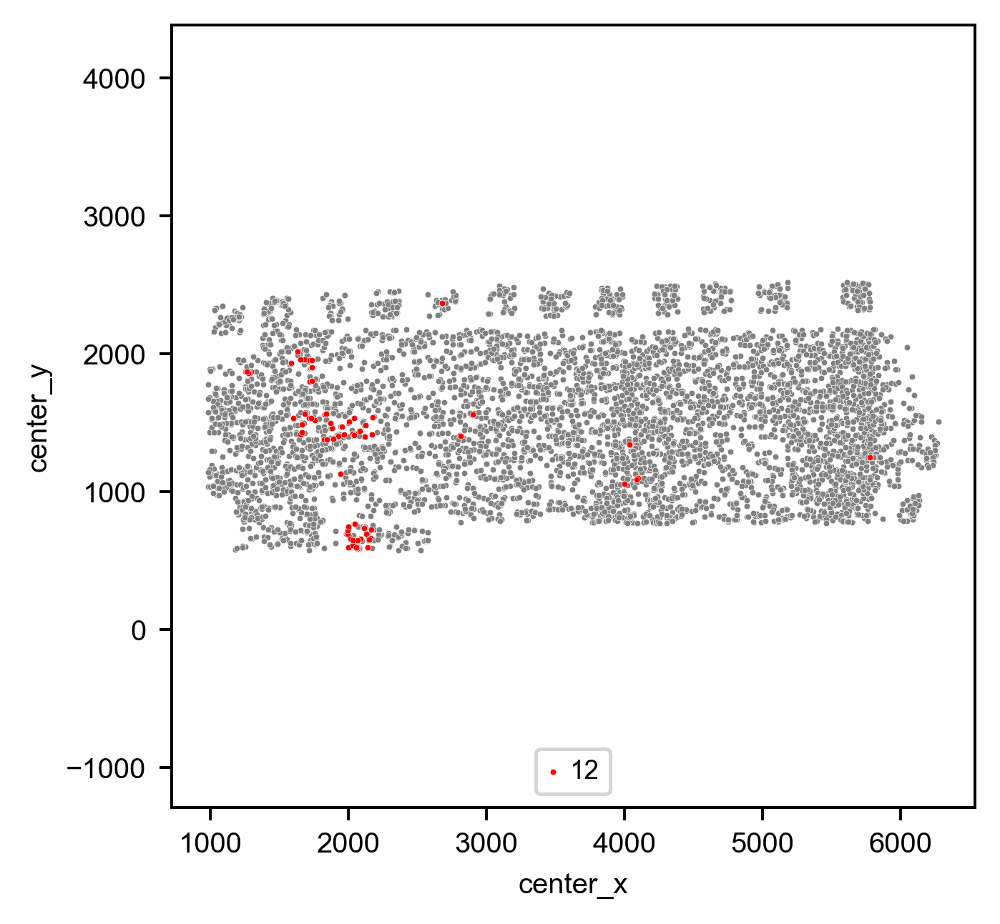

...

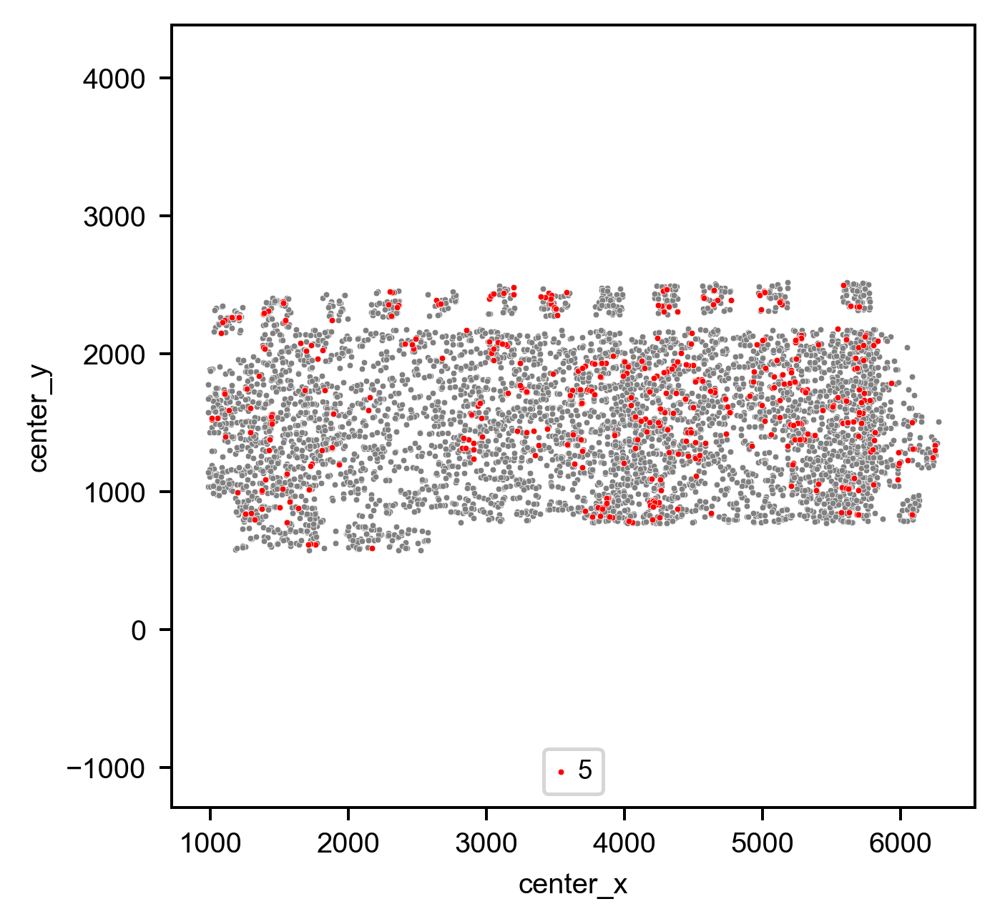

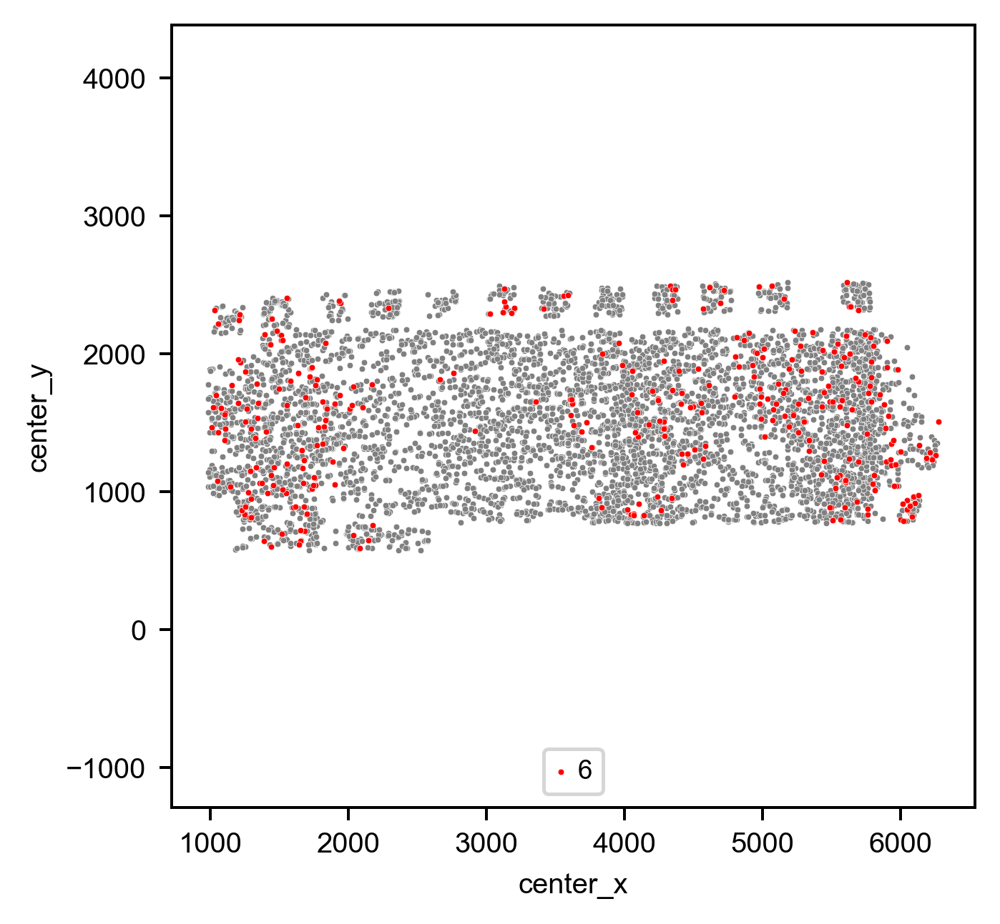

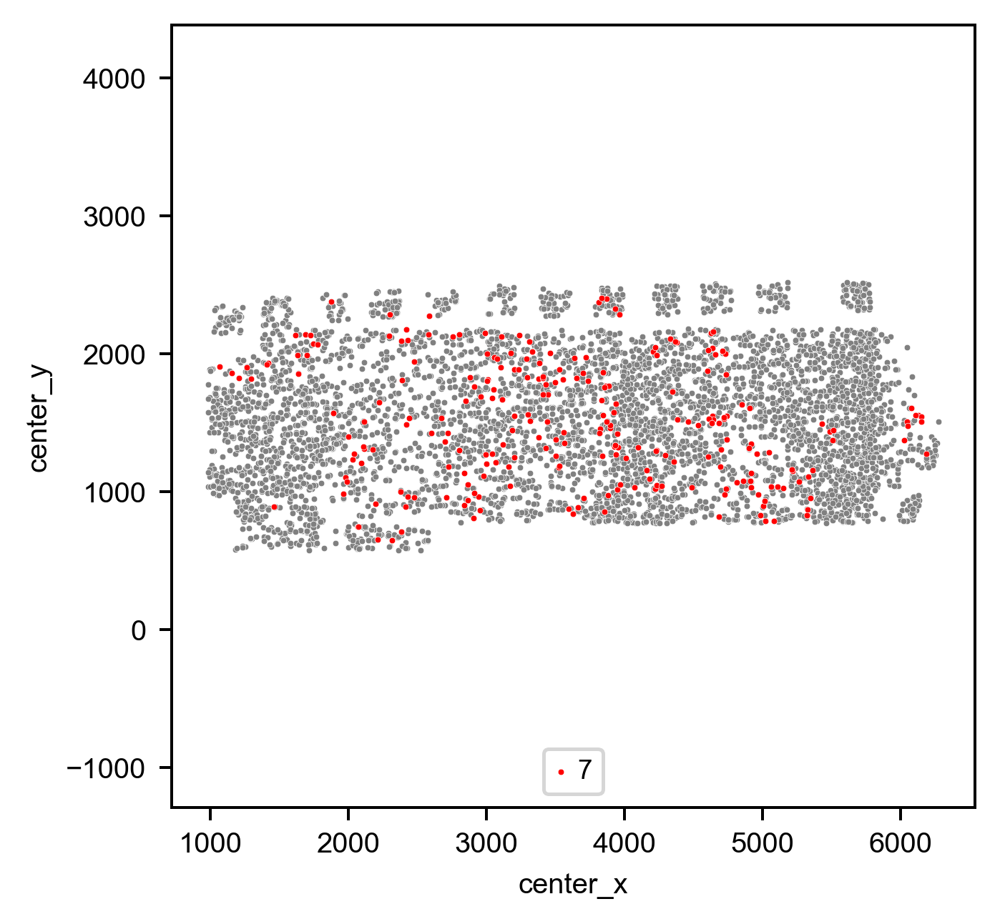

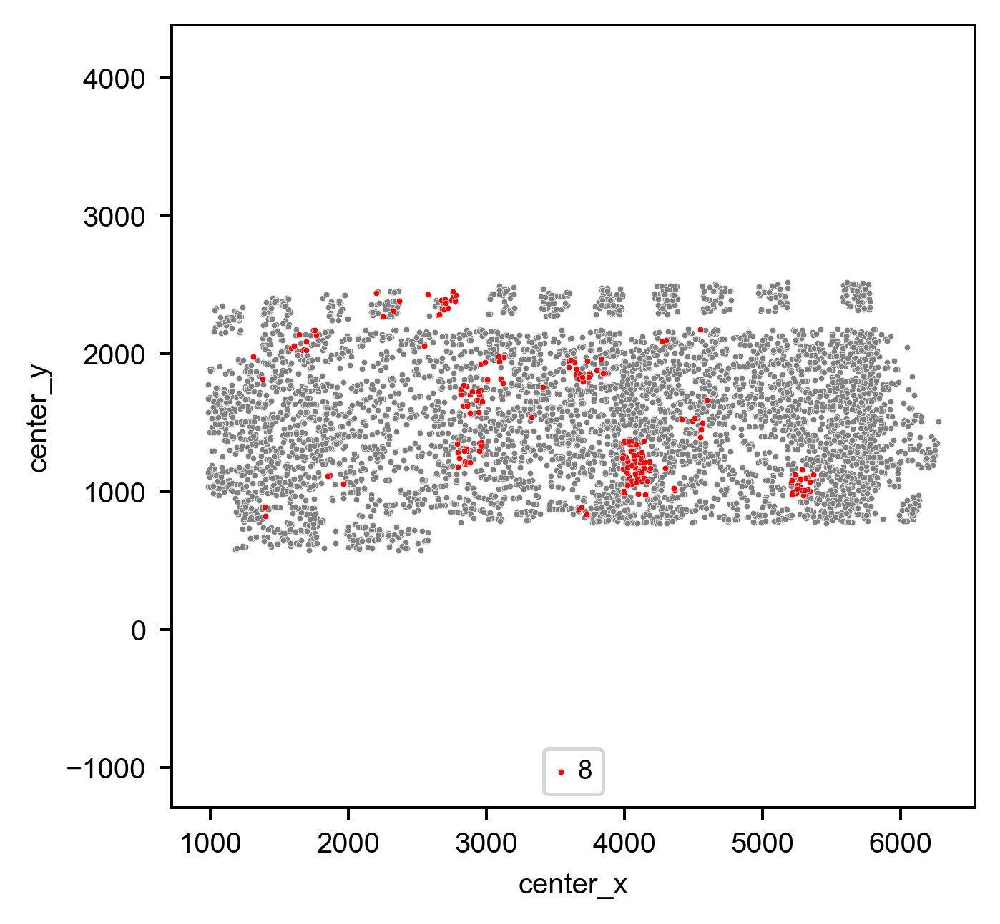

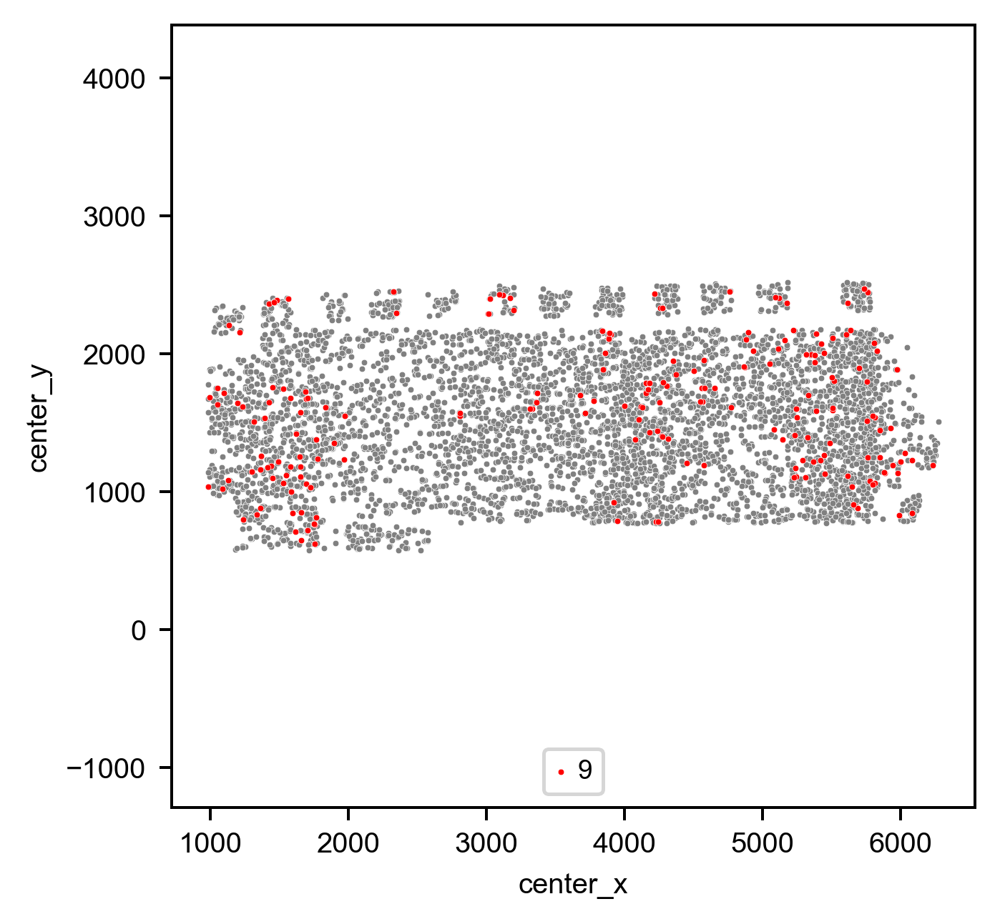

In [212]:
# visualzie the spatial dist for clusters
import matplotlib.pyplot as plt
for _class in np.unique(adata.obs['leiden_cluster']):
    #plt.style.use('dark_background')
    ax = sns.scatterplot(data=adata.obs, x='center_x', y='center_y', 
                    color='grey', s=3, legend=True,)
    ax = sns.scatterplot(data=adata.obs.loc[adata.obs['leiden_cluster']==_class], 
                         x='center_x', y='center_y', 
                    color='r', s=3, legend=True, label=_class)
    ax.grid(False)
    plt.axis('equal')
    hs, ls = ax.get_legend_handles_labels()
    ax.legend(hs,ls, ncol=8, loc=8)
    plt.show()

# 7. Save the analyzed MERFISH adata in h5ad for later use (e.g., cell classifer)

In [225]:
save_filename = os.path.join(os.path.join(postanalysis_folder, 'filtered_cluster_data.h5ad'))

overwrite = True

if not os.path.exists(save_filename) or overwrite:
    print(f"save adata into file: {save_filename}")
    adata.write(save_filename)
else:
    print(f"savefile: {save_filename} already exists")
    

save adata into file: \\mendel\Mendel_SSD3\MERFISH_Analysis\20220601-hSTG\PostAnalysis\filtered_cluster_data.h5ad


# read

E:\Users\puzheng\AppData\anaconda3\envs\merlin_postanalysis\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
E:\Users\puzheng\AppData\anaconda3\envs\merlin_postanalysis\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
E:\Users\puzheng\AppData\anaconda3\envs\merlin_postanalysis\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
E:\Users\puzheng\AppData\anaconda3\envs\merlin_postanalysis\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
E:\Users\puzheng\AppData\anaconda3\envs\merlin_postanalysis\lib\site-packages\scanpy\tools\_rank_genes_groups.py

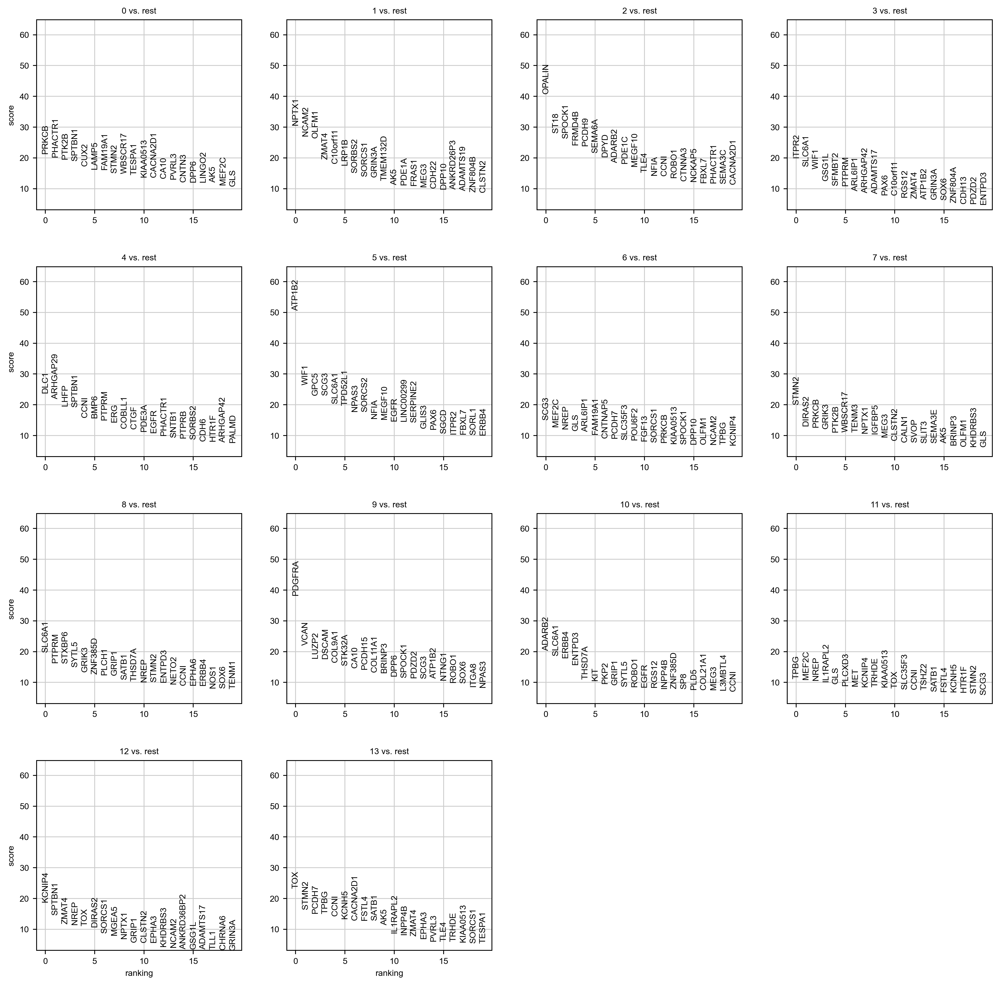

In [137]:
sc.tl.rank_genes_groups(adata, groupby='leiden_subclass', method='t-test')
sc.pl.rank_genes_groups(adata, groupby='leiden_subclass')

In [131]:
{
    '0':'Exc.upper',
    '1':'Exc.mid',
    '2':'OGC',
    '3':'',
    '4':'Endo',
    
}


False

In [132]:
save_filename = r'\\crick\SSD_0\Shiwei\Analysis\20220601_hSTG250_nonclear\filtered_cluster_data.h5ad'

adata_sl = sc.read_h5ad(save_filename)

In [133]:
adata_sl

AnnData object with n_obs × n_vars = 5273 × 250
    obs: 'fov', 'volume', 'center_x', 'center_y', 'min_x', 'max_x', 'min_y', 'max_y', 'n_genes_by_counts', 'total_counts', 'leiden', 'leiden_cluster', 'leiden_subclass'
    var: 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'mean', 'std'
    uns: 'leiden', 'leiden_colors', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [27]:
adata.obs.index[0]

'142320197250352494256072602745612936423'

In [80]:
adata.obs['leiden_cluster'] == '0'

Unnamed: 0
142320197250352494256072602745612936423    False
156761257491587559167497409252249664408    False
189227905858180350481232268208850166860     True
190039597872653147692304476348067612309    False
227464947648899746667305941428287555056    False
                                           ...  
61305065502434563804869613531363898219     False
72692170342086683619306492520586639916     False
74138048957848290081878487802245139874     False
78111406544686444172343830760198752382     False
91387999115559760550902214920664808925     False
Name: leiden_cluster, Length: 5273, dtype: bool

In [128]:
list(df.columns)

['SORBS2',
 'NTNG1',
 'FBN2',
 'PAX6',
 'ADAMTS6',
 'DCN',
 'CHST9',
 'C10orf11',
 'ROR2',
 'SLC22A25',
 'ZNF804B',
 'ANKFN1',
 'ADAM12',
 'ANKRD34B',
 'TNNT2',
 'LMO3',
 'CD163L1',
 'CPED1',
 'ITGA11',
 'POSTN',
 'GAS2L3',
 'COL22A1',
 'ADGRG6',
 'SGCZ',
 'MCTP2',
 'PTCHD4',
 'CDH13',
 'FAT4',
 'ARSJ',
 'SDK1',
 'PALMD',
 'PCDH15',
 'COL21A1',
 'COBLL1',
 'ADAMTSL1',
 'TRPC6',
 'HTR1F',
 'ITGA8',
 'GULP1',
 'MGAT4C',
 'TPD52L1',
 'COL19A1',
 'NRG1',
 'SLC9A2',
 'PDE3A',
 'EYA4',
 'SLC22A3',
 'KLHL1',
 'CHRNA6',
 'ARHGEF28',
 'CDH7',
 'ERG',
 'LINC00299',
 'GREB1L',
 'GPC6',
 'NCKAP5',
 'ARHGAP42',
 'ZBBX',
 'TLL1',
 'TRPC5',
 'SP8',
 'IL1RAPL2',
 'VAV3',
 'SMYD1',
 'CCBE1',
 'PLD5',
 'LRIG3',
 'HTR4',
 'FILIP1',
 'GRID2',
 'SLC44A5',
 'EPHA6',
 'SEMA3D',
 'PKP2',
 'STK32A',
 'POU6F2',
 'ACVR1C',
 'C8orf34',
 'PRKG1',
 'NDNF',
 'GALNTL6',
 'SOX6',
 'SNTB1',
 'FRAS1',
 'DPYD',
 'LRRK1',
 'SGCD',
 'SERPINE2',
 'SLC38A11',
 'TENM1',
 'OLFML2B',
 'TSHZ2',
 'SEMA3A',
 'PTPRB',
 'DACH1',
 'L

In [126]:
for _cls in np.unique(adata.obs['leiden_subclass']):
    mean_exp = df.iloc[np.where(adata.obs['leiden_cluster']==_cls)[0]].values.mean(0)
    print(_cls, df.columns[np.argsort(mean_exp)[:15]].values)
    print(np.where(df.columns[np.argsort(mean_exp)[:]].values == 'GFAP')[0])

0 ['MALAT1' 'ADGRG6' 'TSHZ2' 'TSIX' 'TLL1' 'SP8' 'FBN2' 'POSTN' 'CPED1'
 'SMYD1' 'ANKRD34B' 'ERG' 'DCN' 'COL5A2' 'HGF']
[]
1 ['MALAT1' 'GAS2L3' 'SLC9A2' 'PTPRB' 'ADGRG6' 'C8orf34' 'TNNT2' 'ANKRD34B'
 'TSHZ2' 'CUX2' 'SLC22A25' 'HGF' 'ROR2' 'ZBBX' 'ARHGEF28']
[]
10 ['CD163L1' 'SP8' 'TPBG' 'ADGRG6' 'ROR2' 'SLC22A25' 'SYT10' 'VAV3' 'MALAT1'
 'GPC6' 'HTR4' 'TSIX' 'HGF' 'COL5A2' 'SLC9A2']
[]
11 ['SLC22A25' 'ABCC3' 'CPED1' 'ARHGEF28' 'TRPC5' 'ADAMTS6' 'SLC9A2' 'VAV3'
 'POSTN' 'GAS2L3' 'MET' 'HTR4' 'PCDH15' 'GRHL2' 'SYT10']
[]
12 ['GAS2L3' 'SLC9A2' 'SP8' 'TSIX' 'NTNG1' 'TRPC6' 'SLC22A25' 'ANKRD34B'
 'GPC6' 'LINC00299' 'CUX2' 'ADGRG6' 'SMYD1' 'CPED1' 'TLL1']
[]
13 ['PTPRB' 'HTR4' 'SMYD1' 'IL1RAPL2' 'SP8' 'CD163L1' 'ROR2' 'TNNT2' 'GRHL2'
 'TSIX' 'NDNF' 'SLC9A2' 'GAS2L3' 'ERG' 'SLC22A25']
[]
2 ['SMYD1' 'GAS2L3' 'MALAT1' 'SLC9A2' 'GRHL2' 'SYT10' 'TNNT2' 'HGF'
 'CD163L1' 'ANKRD34B' 'PKP2' 'ABCC3' 'SLC22A25' 'MYO3A' 'ADAMTS6']
[]
3 ['HGF' 'TSHZ2' 'MALAT1' 'SLC22A25' 'PKP2' 'POSTN' 'SLC9A2' 'ADGRG6' 

array([208,  20,  43,  93,  22,  77,  14,  13,  91, 174], dtype=int64)

# 8. Cell type classifier

## 8.1 train classfier with Meng's dataset

In [25]:
meng_merfish_raw = r'\\mendel\Mendel_SSD3\MERFISH_Analysis\Meng_data\counts.h5ad'
merfish_raw = sc.read_h5ad(meng_merfish_raw)
meng_merfish_label = r'\\mendel\Mendel_SSD3\MERFISH_Analysis\Meng_data\cell_labels.csv'
merfish_label = pd.read_csv(meng_merfish_label, index_col=0)

In [26]:
merData = pd.DataFrame(merfish_raw.X, index = merfish_raw.obs.index, columns = merfish_raw.var.index)
labels = merfish_label.loc[merfish_label['label']!='-1']
# merge dataframes
merCluster=merData.merge(labels, how='inner', left_index=True, right_index=True)

index,1700022I11Rik,1810046K07Rik,5031425F14Rik,5730522E02Rik,Acta2,Adam2,Adamts2,Adamts4,Adra1b,Alk,...,Gad2,Tac2,Lamp5,Cnr1,Pvalb,Sst,Rab3b,Slc17a7,Penk,Gad1
index,,,,,,,,,,,,,,,,,,,,,
10000143038275111136124942858811168393,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.659448,0.000000,...,0.261892,0.262109,0.037601,0.010633,0.192950,0.079685,0.063194,0.613834,0.038716,0.000000
100001798412490480358118871918100400402,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,...,0.512115,0.225832,0.093828,0.000000,0.160687,0.171461,0.208027,0.618113,0.051407,0.000000
100006878605830627922364612565348097824,0.0,0.000000,0.0,0.000000,25.567039,0.0,0.000000,0.000000,0.000000,0.000000,...,0.199059,0.114653,0.000000,0.070231,0.144294,0.051351,0.148232,0.448829,0.041903,0.000000
100007228202835962319771548915451072492,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,...,0.240500,0.093413,0.033100,0.151837,0.197471,0.011399,0.110675,1.117577,0.016462,0.467554
100009332472089331948140672873134747603,0.0,0.491629,0.0,0.983257,0.491629,0.0,0.000000,0.000000,0.983257,0.000000,...,1.726676,0.533404,3.691514,0.000000,0.296567,0.748264,1.423427,11.386119,0.387408,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99987465505639073211021560543065098772,0.0,0.000000,0.0,0.557620,0.000000,0.0,0.000000,0.000000,0.557620,2.788098,...,4.711612,1.145445,0.000000,0.362137,1.549598,0.195306,4.132728,1.586415,0.152228,8.515803
99989592830367590092304100078674096866,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.000000,1.829112,14.632893,0.000000,...,0.354238,0.160562,0.630489,0.030634,0.073509,0.000000,0.210928,4.954309,0.140572,0.107833
99991756591196613545069880666241120777,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,...,0.944207,0.221704,0.139209,0.854429,0.296027,0.110999,0.432686,5.654802,0.042431,0.004518


In [28]:
from sklearn import preprocessing
# Scale variable measurements for model training
merGroupedDataZ = pd.DataFrame(preprocessing.scale(merCluster.iloc[:,:-5]),index = merCluster.iloc[:,:-5].index, columns = merCluster.iloc[:,:-5].columns)

merGroupedDataZ['subclass'] = merCluster.iloc[:,-2]

E:\Users\puzheng\anaconda3\envs\ia3_postanalysis\lib\site-packages\sklearn\preprocessing\_data.py:194: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn("Numerical issues were encountered "
E:\Users\puzheng\anaconda3\envs\ia3_postanalysis\lib\site-packages\sklearn\preprocessing\_data.py:211: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn("Numerical issues were encountered "


## 8.2 train classfier with Meng's dataset

In [30]:
adata_ref = merGroupedDataZ

# Train the classifer using the shared varibales
genes_from_ref = set(merData.columns)
genes = list(genes_from_ref.intersection(set(adata.var.index)))

In [32]:
%%time
from sklearn.neural_network import MLPClassifier

# Train a classifier
gene_ids = [merData.columns.get_loc(g) for g in genes]

print('Train cell type classifier.')

X = np.array(adata_ref.iloc[:,:-1])[:, gene_ids]
Y = np.array(adata_ref['subclass'])
nnc = MLPClassifier(max_iter = 500)
nnc.fit(X, Y)

Train cell type classifier.
Wall time: 5min 24s


MLPClassifier(max_iter=500)

# 8.3 initial prediction

In [33]:
%run "..\..\Startup_py3.py"
sys.path.append(r"..\..\..\..\Documents")

import ImageAnalysis3 as ia
%matplotlib inline

In [34]:
import ImageAnalysis3.celltype_tools.classifier as clsf

Predict cell types.


C:\Users\puzheng\AppData\Local\Temp/ipykernel_30876/502447268.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  prediction_counts['count'] = 1


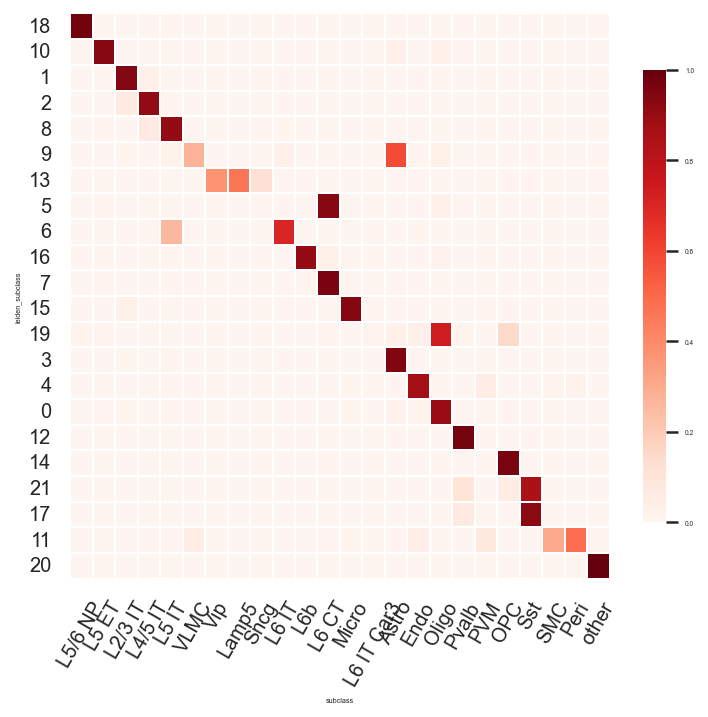

In [36]:
prediction_column = 'subclass_prediction_label'

ref_cluster_column = 'subclass'

# determine which class to query
query_cluster_column = 'leiden_subclass'
#query_cluster_column = 'leiden_cluster'

print('Predict cell types.')
clsf.predict_classes(nnc, adata, prediction_column, genes)
 
    
## Count predictions
prediction_counts = adata.obs[[query_cluster_column, prediction_column]]
prediction_counts['count'] = 1

predictionMatrix = pd.pivot_table(prediction_counts, index=[query_cluster_column],
               columns=[prediction_column], values='count', aggfunc=np.sum).fillna(0)

predictionMatrix['total'] = predictionMatrix.sum(axis = 1)
    
fractions = predictionMatrix.iloc[:,:-1].div(predictionMatrix['total'],axis = 0)
    
#fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Columns')
fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Both')
    
# Plot
fig1=plt.figure(figsize = (6,5))
sns.set(font_scale=0.3)
#sns.heatmap(fractions_sorted, cmap='Greys', vmin=0, vmax=1, cbar=True, linewidths=.05,cbar_kws={"shrink": .6})
    
sns.heatmap(fractions_sorted, cmap='Reds', vmin=0, vmax=1, cbar=True, linewidths=.05,cbar_kws={"shrink": .8})
    
plt.tick_params(axis='x', labelsize=10)
plt.tick_params(axis='y', labelsize=10)   
plt.xticks(rotation = 60)
plt.yticks(rotation = 'horizontal')
plt.xlabel(ref_cluster_column) 
plt.ylabel(query_cluster_column)
plt.show()

In [55]:
sc.settings.n_jobs = 24
sc.settings.figdir = postanalysis_folder
sc.settings.set_figure_params(dpi=150, dpi_save=300, frameon=False, 
                              figsize=(4, 4), fontsize=8, facecolor='white',)

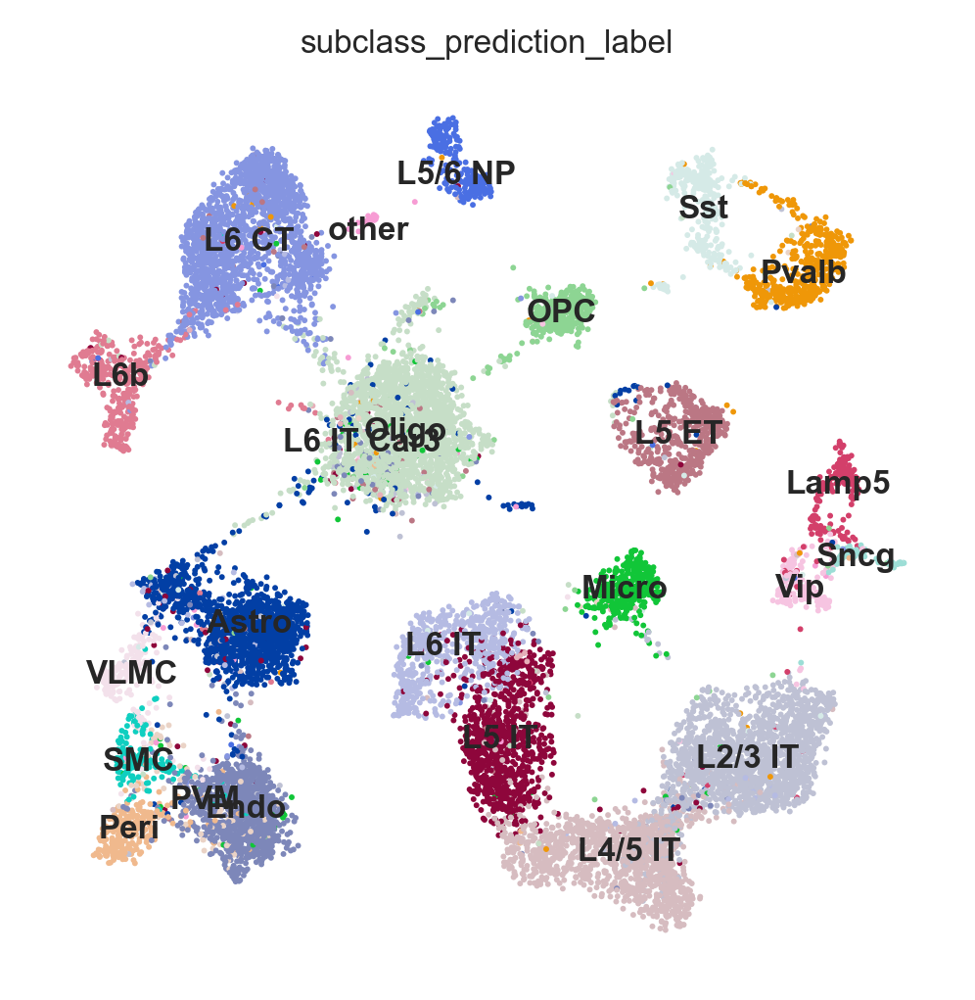

In [38]:
# Plot the predicted labels on UMAP to guide the manual labeling of the de novo clustering below
# use this to manually merge and split the original query column (e.g., leiden_subclass)
sc.pl.umap(adata, color='subclass_prediction_label', legend_loc='on data')

### plot clustering as ref

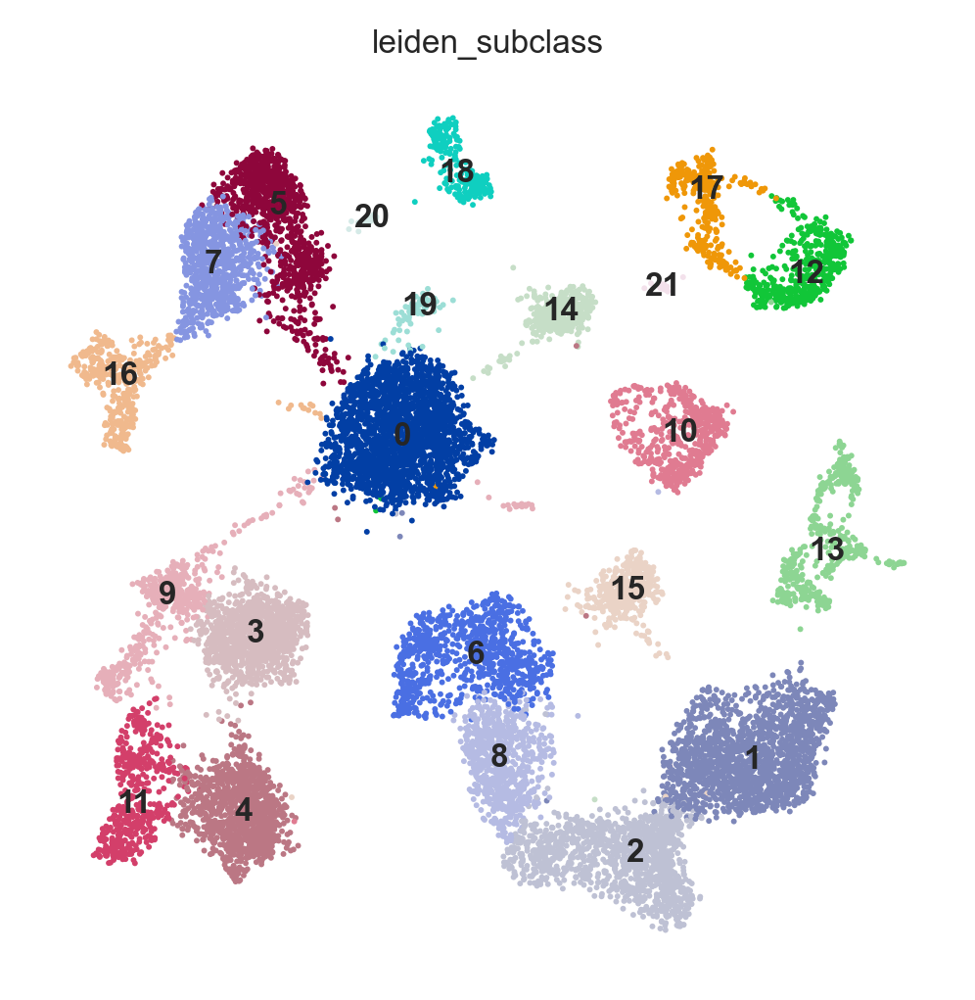

In [39]:
sc.pl.umap(adata, color='leiden_subclass', legend_loc='on data')

## 8.4 Split labels

by comparing two UMAP above, we could estimate which cluster should be further splitted

In [176]:
adata.obs['leiden_subclass_sub'] = adata.obs['leiden_subclass'] 
sc.tl.leiden(adata, resolution=0.3,restrict_to=('leiden_subclass_sub',['0']),
             key_added='leiden_subclass_sub')
sc.tl.leiden(adata, resolution=0.5,restrict_to=('leiden_subclass_sub',['13']),
             key_added='leiden_subclass_sub')
sc.tl.leiden(adata, resolution=1,restrict_to=('leiden_subclass_sub',['13,1']),
             key_added='leiden_subclass_sub')
#sc.tl.leiden(adata, resolution=0.8,restrict_to=('leiden_subclass_sub',['13,1,2']),
#             key_added='leiden_subclass_sub')
sc.tl.leiden(adata, resolution=0.2,restrict_to=('leiden_subclass_sub',['11']),
             key_added='leiden_subclass_sub')
sc.tl.leiden(adata, resolution=0.2,restrict_to=('leiden_subclass_sub',['9']),
             key_added='leiden_subclass_sub')
sc.tl.leiden(adata, resolution=0.5,restrict_to=('leiden_subclass_sub',['4']),
             key_added='leiden_subclass_sub')


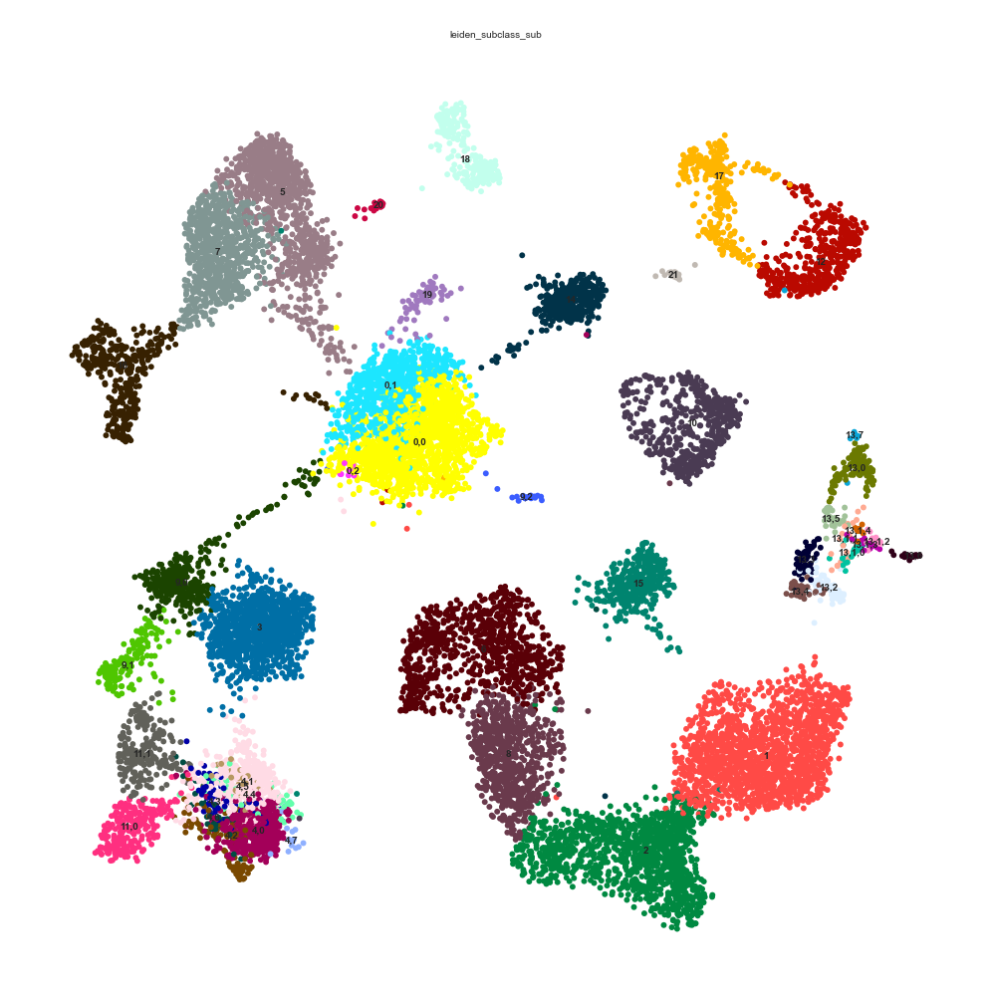

In [177]:
sc.pl.umap(adata, color='leiden_subclass_sub', legend_loc='on data', cmap='Spectral')

## 8.5 further predict splitted groups

Predict cell types.


C:\Users\puzheng\AppData\Local\Temp/ipykernel_30876/1454245228.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  prediction_counts['count'] = 1


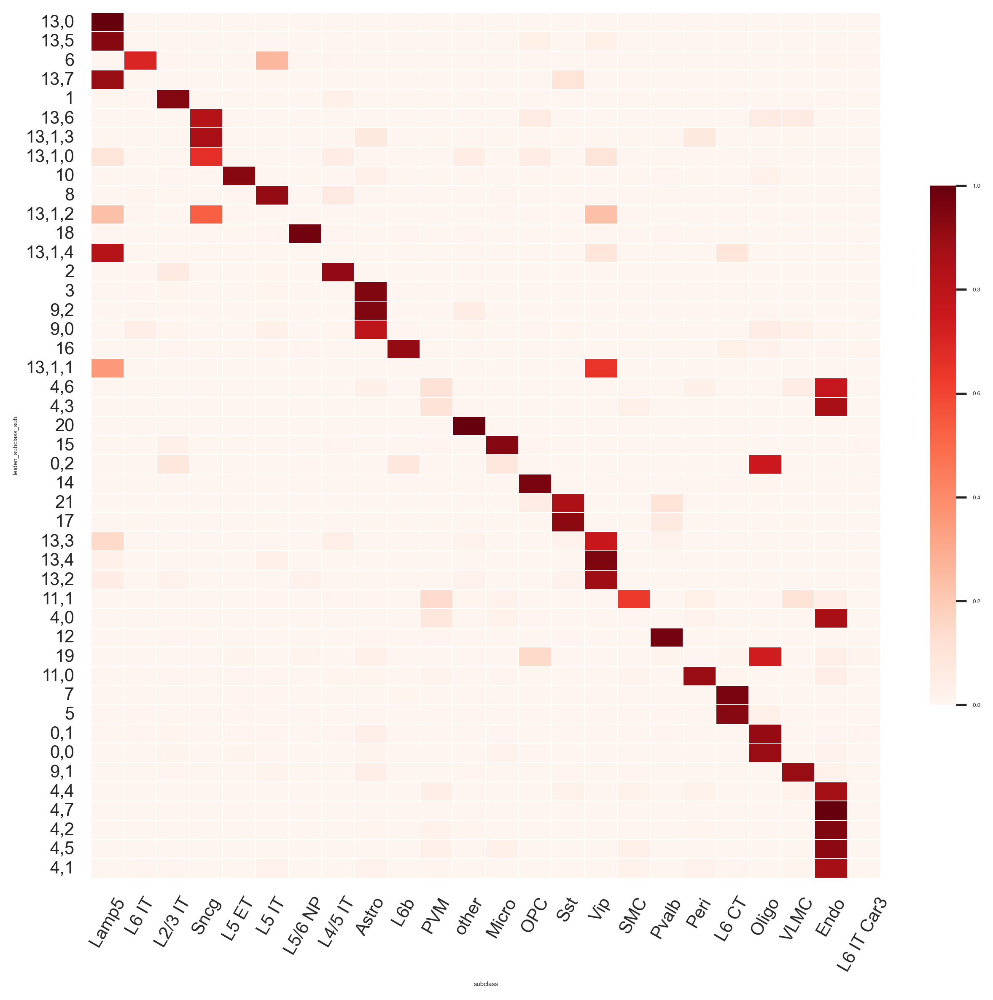

In [178]:
prediction_column = 'subclass_prediction_label'

ref_cluster_column = 'subclass'

# determine which class to query
query_cluster_column = 'leiden_subclass_sub'
#query_cluster_column = 'leiden_cluster'

print('Predict cell types.')
clsf.predict_classes(nnc, adata, prediction_column, genes)
 
    
## Count predictions
prediction_counts = adata.obs[[query_cluster_column, prediction_column]]
prediction_counts['count'] = 1

predictionMatrix = pd.pivot_table(prediction_counts, index=[query_cluster_column],
               columns=[prediction_column], values='count', aggfunc=np.sum).fillna(0)

predictionMatrix['total'] = predictionMatrix.sum(axis = 1)
    
fractions = predictionMatrix.iloc[:,:-1].div(predictionMatrix['total'],axis = 0)
    
#fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Columns')
fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Both')
    
# Plot
fig1=plt.figure(figsize = (10,9))
sns.set(font_scale=0.3)
#sns.heatmap(fractions_sorted, cmap='Greys', vmin=0, vmax=1, cbar=True, linewidths=.05,cbar_kws={"shrink": .6})
    
sns.heatmap(fractions_sorted, cmap='Reds', vmin=0, vmax=1, cbar=True, linewidths=.05,cbar_kws={"shrink": .6})
    
plt.tick_params(axis='x', labelsize=10)
plt.tick_params(axis='y', labelsize=10)   
plt.xticks(rotation = 60)
plt.yticks(rotation = 'horizontal')
plt.xlabel(ref_cluster_column) 
plt.ylabel(query_cluster_column)
plt.show()

## 8.6 Assign most of uniquely classfied clusters

In [179]:
first_assign_dict = {}
# Automatic assign best fit if applicable
assign_th = 0.6
for _cluster, _vec in fractions.iterrows():
    #_cluster, _vec
    _matched_inds = np.where(_vec >= assign_th)[0]
    # if uniquely matched:
    if len(_matched_inds) == 1:
        print(_cluster, list(_vec.keys())[_matched_inds[0]])
        first_assign_dict[_cluster] = list(_vec.keys())[_matched_inds[0]]

0,0 Oligo
0,1 Oligo
0,2 Oligo
1 L2/3 IT
2 L4/5 IT
3 Astro
4,0 Endo
4,1 Endo
4,2 Endo
4,3 Endo
4,4 Endo
4,5 Endo
4,6 Endo
4,7 Endo
5 L6 CT
6 L6 IT
7 L6 CT
8 L5 IT
9,0 Astro
9,1 VLMC
9,2 Astro
10 L5 ET
11,0 Peri
11,1 SMC
12 Pvalb
13,0 Lamp5
13,1,0 Sncg
13,1,1 Vip
13,1,3 Sncg
13,1,4 Lamp5
13,2 Vip
13,3 Vip
13,4 Vip
13,5 Lamp5
13,6 Sncg
13,7 Lamp5
14 OPC
15 Micro
16 L6b
17 Sst
18 L5/6 NP
19 Oligo
20 other
21 Sst


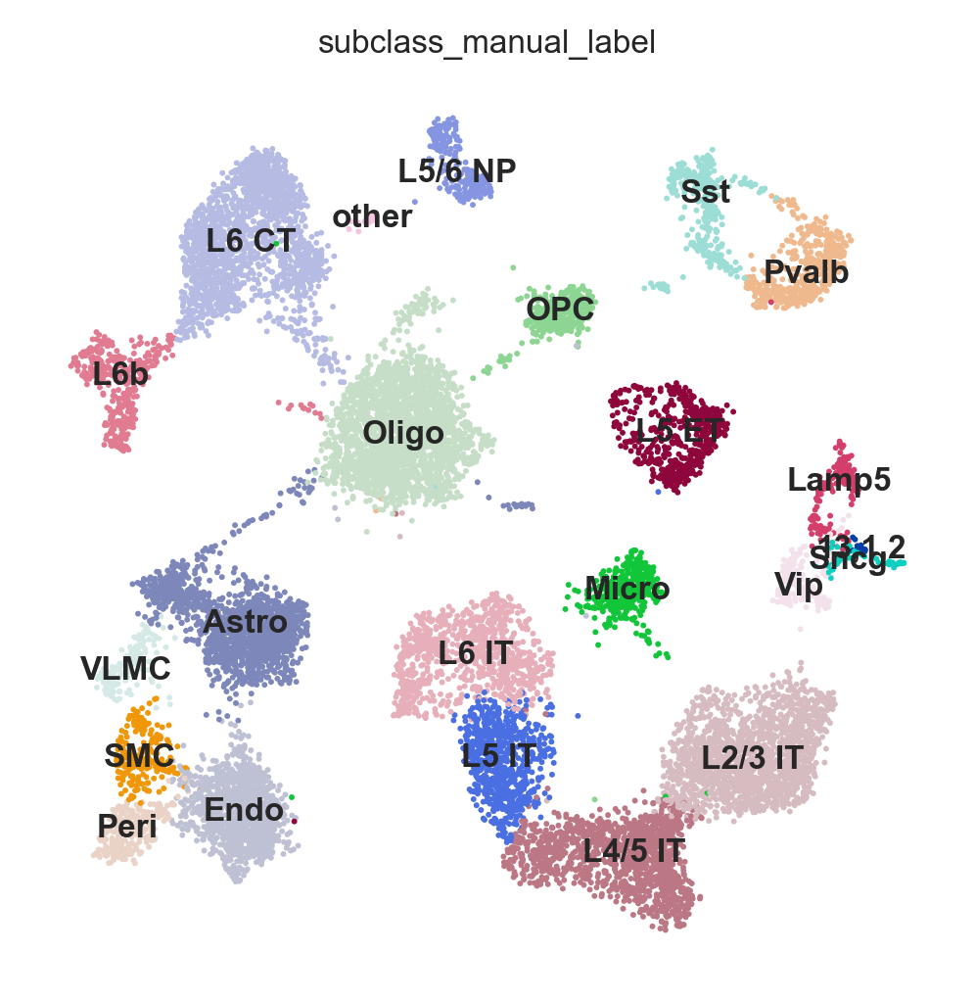

In [183]:
adata.obs['subclass_manual_label'] = adata.obs['leiden_subclass_sub'] 
adata.obs = adata.obs.replace({'subclass_manual_label':first_assign_dict})
# Check the leftover
np.unique(adata.obs['subclass_manual_label'])
# Plot the predicted sub-subclass
sc.pl.umap(adata, color='subclass_manual_label', legend_loc='on data',)

## 8.7 Manual assign leftovers

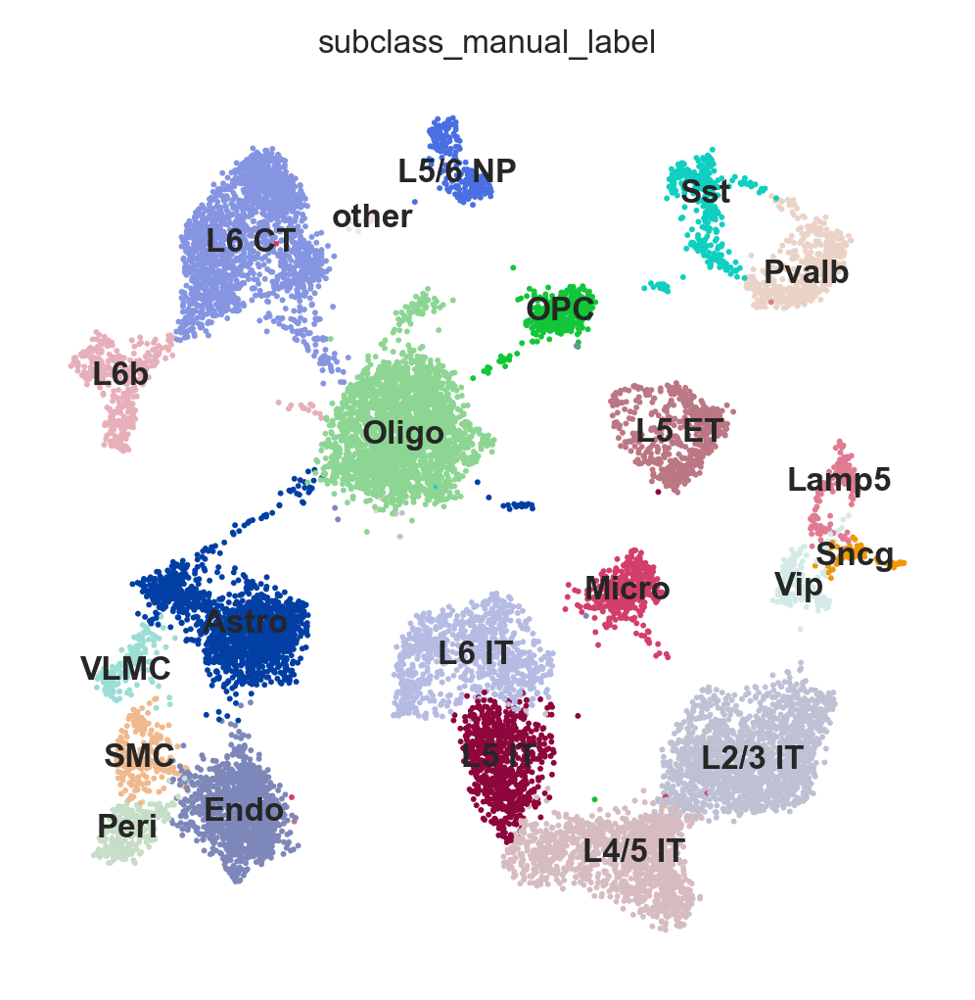

In [182]:
#adata.obs = adata.obs.replace({'subclass_manual_label':{'6':'L6 IT'}})
#adata.obs = adata.obs.replace({'subclass_manual_label':{'9,0':'Astro'}})
#adata.obs = adata.obs.replace({'subclass_manual_label':{'11,1':'SMC'}})
#adata.obs = adata.obs.replace({'subclass_manual_label':{'19':'Oligo', '0,2':'Oligo'}})
adata.obs = adata.obs.replace({'subclass_manual_label':{'13,1,2':'Sncg'}})
#adata.obs = adata.obs.replace({'subclass_manual_label':{'13,3':'Vip'}})

np.unique(adata.obs['subclass_manual_label'])

sc.pl.umap(adata, color='subclass_manual_label', legend_loc='on data',)

# 9. Redo prediction for manual labels

Check consistency between manual labels vs. predict labels

Predict cell types: subclass_manual_label


C:\Users\puzheng\AppData\Local\Temp/ipykernel_30876/1525045723.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  prediction_counts['count'] = 1


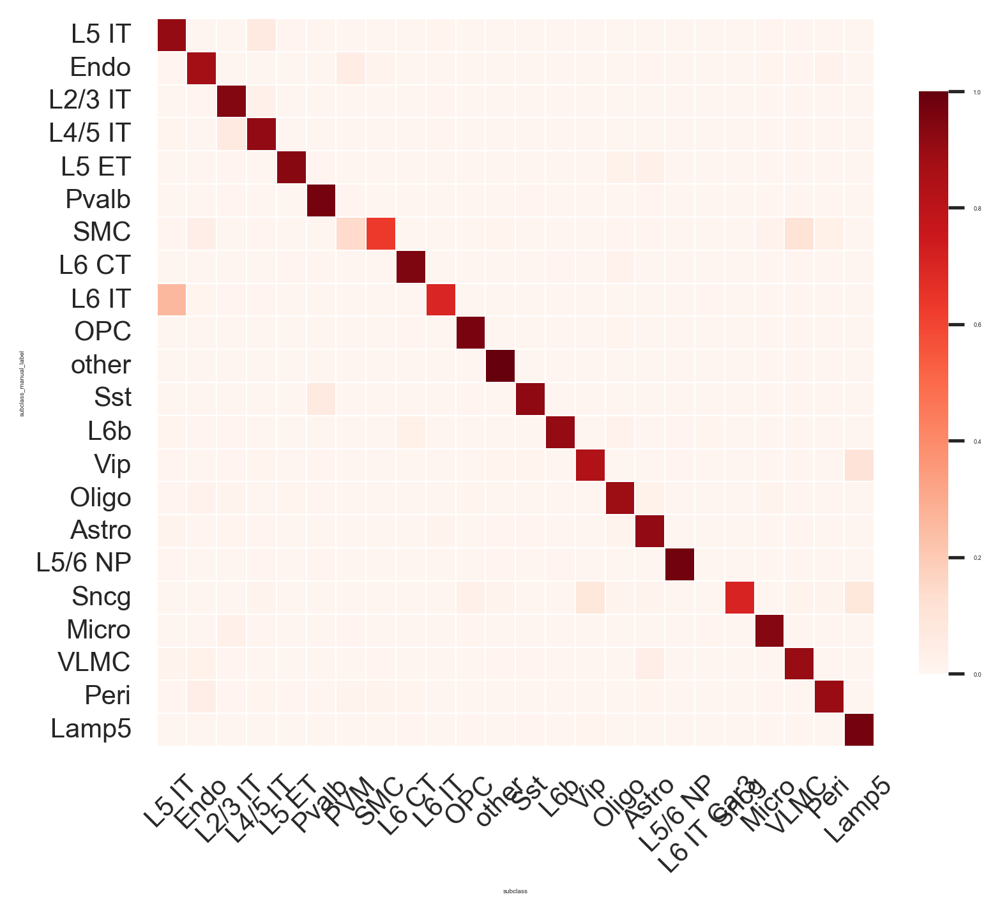

In [174]:
prediction_column = 'subclass_manual_label_predict'

ref_cluster_column = 'subclass'

# determine which class to query
query_cluster_column = 'subclass_manual_label'

print(f'Predict cell types: {query_cluster_column}')
clsf.predict_classes(nnc, adata, prediction_column, genes)
 
    
## Count predictions
prediction_counts = adata.obs[[query_cluster_column, prediction_column]]
prediction_counts['count'] = 1

predictionMatrix = pd.pivot_table(prediction_counts, index=[query_cluster_column],
               columns=[prediction_column], values='count', aggfunc=np.sum).fillna(0)

predictionMatrix['total'] = predictionMatrix.sum(axis = 1)
    
fractions = predictionMatrix.iloc[:,:-1].div(predictionMatrix['total'],axis = 0)
    
#fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Columns')
fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Both')
    
# Plot
fig1=plt.figure(figsize = (6,5))
sns.set(font_scale=0.2)

sns.heatmap(fractions_sorted, cmap='Reds', vmin=0, vmax=1, cbar=True, linewidths=.05,cbar_kws={"shrink": .8})
    
plt.tick_params(axis='x', labelsize=10)
plt.tick_params(axis='y', labelsize=10)   
plt.xticks(rotation = 45)
plt.yticks(rotation = 'horizontal')
plt.xlabel(ref_cluster_column) 
plt.ylabel(query_cluster_column)
plt.show()

# 10. Save manually labeled data

In [175]:
save_filename = os.path.join(os.path.join(postanalysis_folder, 'manual_labeled_data.h5ad'))

overwrite = True

if not os.path.exists(save_filename) or overwrite:
    print(f"save adata into file: {save_filename}")
    adata.write(save_filename)
else:
    print(f"savefile: {save_filename} already exists")

save adata into file: \\mendel\Mendel_SSD3\MERFISH_Analysis\20220415-M1_renamed_storm65\PostAnalysis\manual_labeled_data.h5ad
